In [1]:
import datetime
import pandas as pd
import quandl
import matplotlib.pyplot as plt
import math
import numpy as np
import time
import gc
from quandl import QuandlError
plt.style.use('alex')

pd.options.display.max_rows = 400
pd.options.display.float_format = '{:,.4f}'.format

In [2]:
from MarketAssist import Market as Market

In [10]:
W = Market.Market(Market_file = 'C:/Users/awright/Desktop/January 2018/Other/trading/Market Histories/WIKIP2000_trimmed_filled.csv'
                  ,mavg_df_file = 'C:/Users/awright/Desktop/January 2018/Other/trading/Market Histories/WIKIP2000_trim_fill_mavgdf.csv' )

In [26]:
W.mavg_df.head()

,A-1mavg,A-30mavg,A-5mavg,AA-1mavg,AA-30mavg,AA-5mavg,AAL-1mavg,AAL-30mavg,AAL-5mavg,AAN-1mavg,...,ZIXI-5mavg,ZNGA-1mavg,ZNGA-30mavg,ZNGA-5mavg,ZOES-1mavg,ZOES-30mavg,ZOES-5mavg,ZTS-1mavg,ZTS-30mavg,ZTS-5mavg
0,46.176384,NaN,NaN,28.83,NaN,NaN,46.004869,NaN,NaN,31.827199,...,NaN,2.65,NaN,NaN,23.48,NaN,NaN,53.287880,NaN,NaN
1,46.782269,NaN,NaN,30.26,NaN,NaN,46.402320,NaN,NaN,32.495670,...,NaN,2.69,NaN,NaN,24.63,NaN,NaN,53.804949,NaN,NaN
2,46.226047,NaN,NaN,30.65,NaN,NaN,45.597483,NaN,NaN,31.238546,...,NaN,2.65,NaN,NaN,25.55,NaN,NaN,53.625963,NaN,NaN
3,47.666265,NaN,NaN,30.68,NaN,NaN,45.915443,NaN,NaN,30.789573,...,NaN,2.72,NaN,NaN,25.76,NaN,NaN,53.795005,NaN,NaN
4,47.815254,NaN,46.933244,29.48,NaN,29.98,46.779898,NaN,46.140003,31.178683,...,4.94,2.66,NaN,2.674,23.66,NaN,24.616,53.645851,NaN,53.63193


In [12]:
maxs = W.History[['Symbol','Close']].groupby('Symbol').max()
mins = W.History[['Symbol','Close']].groupby('Symbol').min()

norm_df = W.History[['Symbol','Date','Close']]
norm_df['NormPrice'] = norm_df[['Symbol','Close']].groupby('Symbol').transform(lambda x: (x - min(x)) / ( max(x) - min(x)))

C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [13]:
windows = [1,10,50]
datestart = min(norm_df.Date)


dateend = (str((datetime.datetime.now().date().year))
          + '-' + str((datetime.datetime.now().date().month))
          + '-' + str((datetime.datetime.now().date().day)))


symbols = norm_df.Symbol.unique()

mavg_dict = {'Date':norm_df[(norm_df['Date'] >= datestart) 
                                      & (norm_df['Date'] <= dateend)].Date.unique()}

for symbol in symbols:

    for window in windows:

        label = symbol + '-' + str(window) + 'mavg'

        mavg_dict[label] = norm_df[(norm_df['Symbol'] == symbol) &
                                     (norm_df['Date'] >= datestart) 
                                      & (norm_df['Date'] <= dateend)].NormPrice.rolling(window=window).mean().values

norm_mavg_df = pd.DataFrame(mavg_dict)

In [14]:
norm_mavg_df

,A-10mavg,A-1mavg,A-50mavg,AA-10mavg,AA-1mavg,AA-50mavg,AAL-10mavg,AAL-1mavg,AAL-50mavg,AAN-10mavg,...,ZIXI-50mavg,ZNGA-10mavg,ZNGA-1mavg,ZNGA-50mavg,ZOES-10mavg,ZOES-1mavg,ZOES-50mavg,ZTS-10mavg,ZTS-1mavg,ZTS-50mavg
0,nan,0.0000,nan,nan,0.0000,nan,nan,0.3185,nan,nan,...,nan,nan,0.0843,nan,nan,0.8476,nan,nan,0.0350,nan
1,nan,0.0212,nan,nan,0.0508,nan,nan,0.3402,nan,nan,...,nan,nan,0.1067,nan,nan,0.9245,nan,nan,0.0536,nan
2,nan,0.0017,nan,nan,0.0646,nan,nan,0.2962,nan,nan,...,nan,nan,0.0843,nan,nan,0.9860,nan,nan,0.0471,nan
3,nan,0.0520,nan,nan,0.0657,nan,nan,0.3136,nan,nan,...,nan,nan,0.1236,nan,nan,1.0000,nan,nan,0.0532,nan
4,nan,0.0572,nan,nan,0.0231,nan,nan,0.3609,nan,nan,...,nan,nan,0.0899,nan,nan,0.8596,nan,nan,0.0479,nan
5,nan,0.0558,nan,nan,0.0763,nan,nan,0.4369,nan,nan,...,nan,nan,0.0562,nan,nan,0.8583,nan,nan,0.0471,nan
6,nan,0.0957,nan,nan,0.1115,nan,nan,0.4456,nan,nan,...,nan,nan,0.0730,nan,nan,0.8189,nan,nan,0.0249,nan
7,nan,0.0704,nan,nan,0.1495,nan,nan,0.4163,nan,nan,...,nan,nan,0.0955,nan,nan,0.7841,nan,nan,0.0278,nan
8,nan,0.0763,nan,nan,0.1484,nan,nan,0.3918,nan,nan,...,nan,nan,0.0787,nan,nan,0.7420,nan,nan,0.0403,nan
9,0.0494,0.0635,nan,0.0825,0.1353,nan,0.3663,0.3429,nan,0.2421,...,nan,0.0865,0.0730,nan,0.8519,0.6979,nan,0.0399,0.0217,nan


In [107]:
sym_df

,Date,HAWK-1mavg,HAWK-10mavg,HAWK-30mavg,Symbol,Trend,Reversal,Return
0,2017-01-03,0.3633,0.0000,0.0000,HAWK,0,0,0
1,2017-01-04,0.4173,0.0000,0.0000,HAWK,0,0,0
2,2017-01-05,0.3741,0.0000,0.0000,HAWK,0,0,0
3,2017-01-06,0.3597,0.0000,0.0000,HAWK,0,0,0
4,2017-01-09,0.3417,0.0000,0.0000,HAWK,0,0,0
5,2017-01-10,0.2950,0.0000,0.0000,HAWK,0,0,0
6,2017-01-11,0.2914,0.0000,0.0000,HAWK,0,0,0
7,2017-01-12,0.2986,0.0000,0.0000,HAWK,0,0,0
8,2017-01-13,0.3237,0.0000,0.0000,HAWK,0,0,0
9,2017-01-17,0.2410,0.3306,0.0000,HAWK,0,0,0


In [126]:
headers = ['Date'] + [str(win) + 'mavg' for win in windows] + ['Symbol','Trend','Reversal','Return']
reversals = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64'}, parse_date = 'Date')

all_sym_df = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64'}, parse_date = 'Date')

for symbol in W.symbols:
    cols = ['Date']
    for window in windows:
        col = symbol + '-' + str(window) + 'mavg'
        cols.append(col)
        
    sym_df = norm_mavg_df.loc[:,cols]
    sym_df = sym_df.fillna(0)
    sym_df['Symbol'] = symbol
    sym_df['Trend'] = sym_df[cols[2]] < sym_df[cols[3]]
    sym_df = sym_df*1
    sym_df['Reversal'] = 0
    sym_df.loc[sym_df['Trend'] < sym_df['Trend'].shift(1), 'Reversal'] = -1
    sym_df.loc[sym_df['Trend'] > sym_df['Trend'].shift(1), 'Reversal'] = 1
    
    sym_df['Return'] = sym_df[cols[1]] - sym_df[cols[1]].shift(1)
    sym_df.loc[sym_df['Reversal'] == -1,'Return'] = -sym_df['Return']
    sym_df.columns = headers
    sym_df['Diff'] = sym_df[headers[2]] / sym_df[headers[3]]
    
    rev_df = sym_df[sym_df['Reversal'] != 0]
    reversals = pd.concat([reversals,rev_df], ignore_index = True)
    all_sym_df = pd.concat([all_sym_df,sym_df],ignore_index = True)

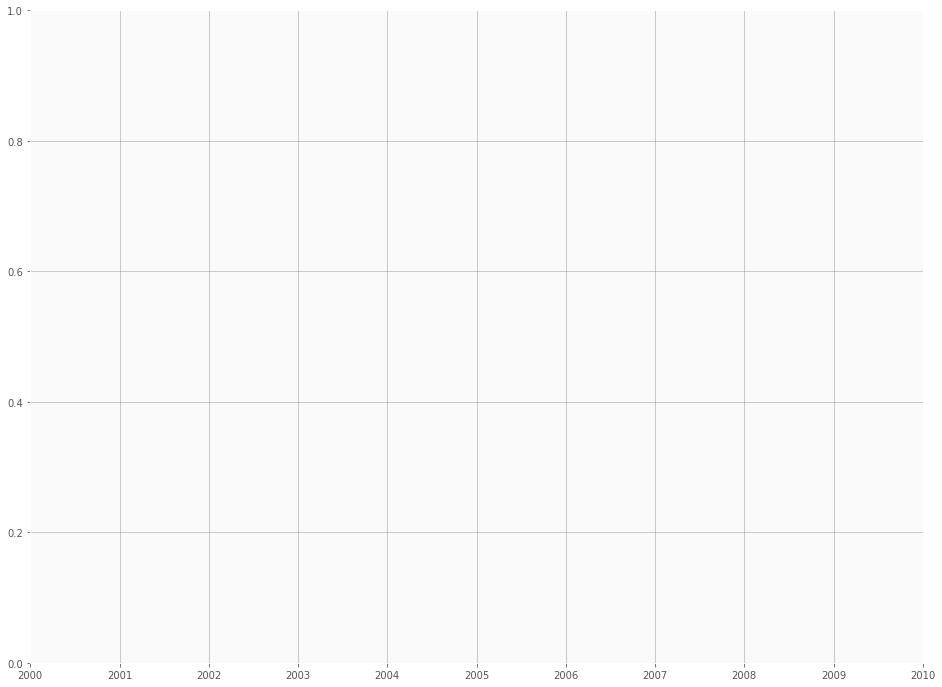

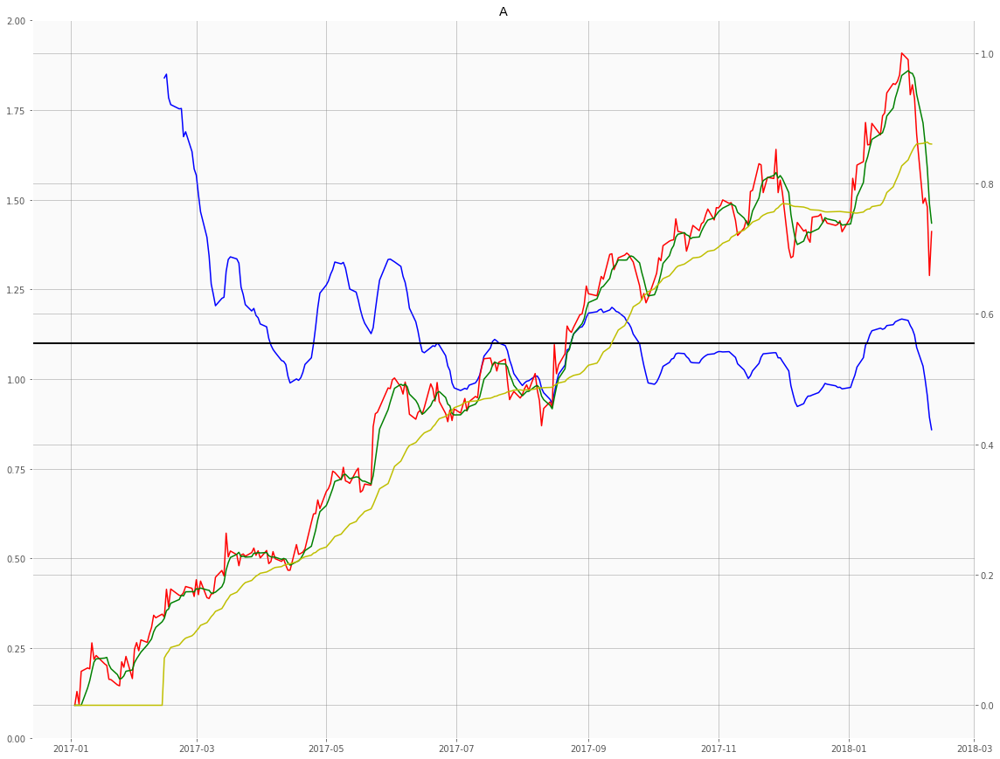

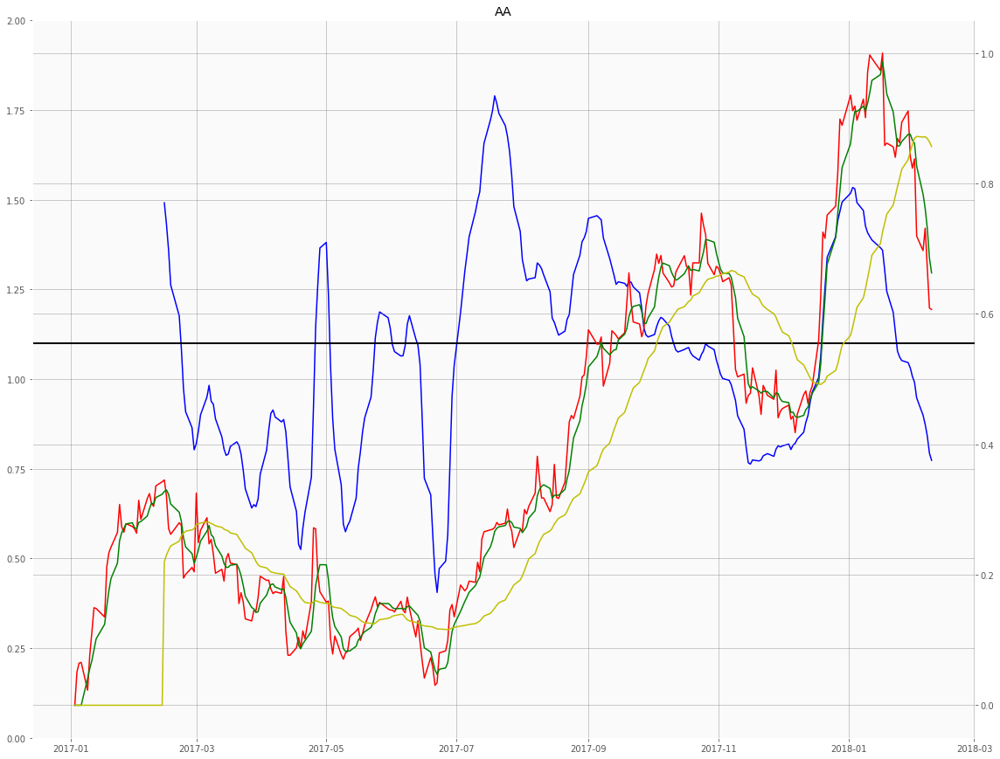

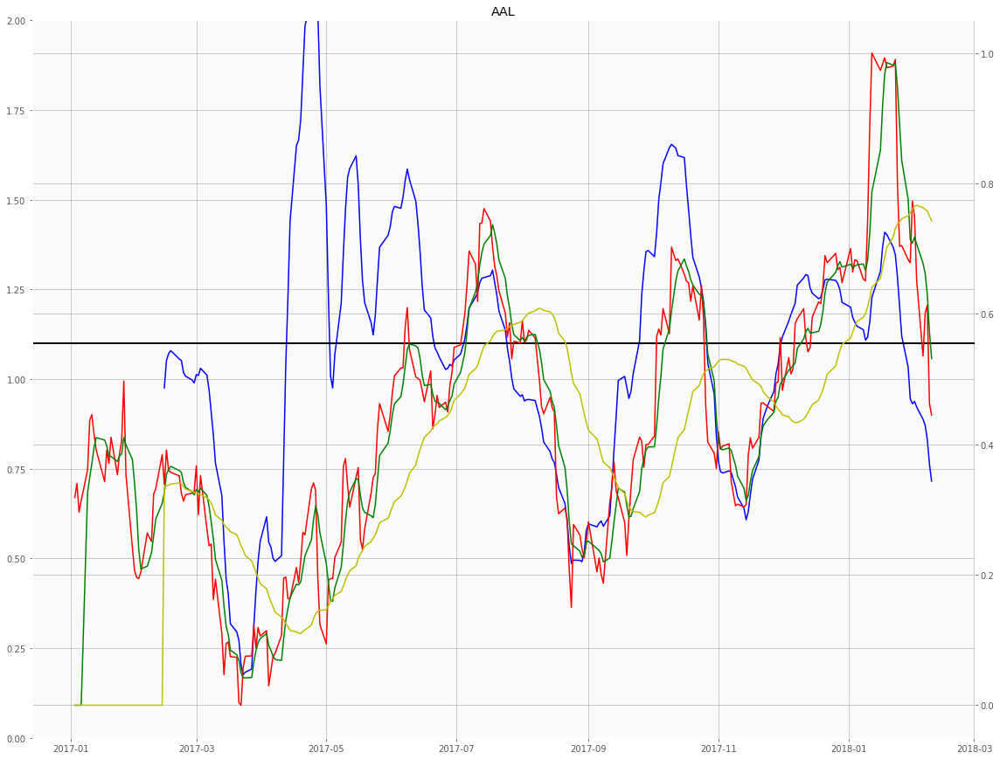

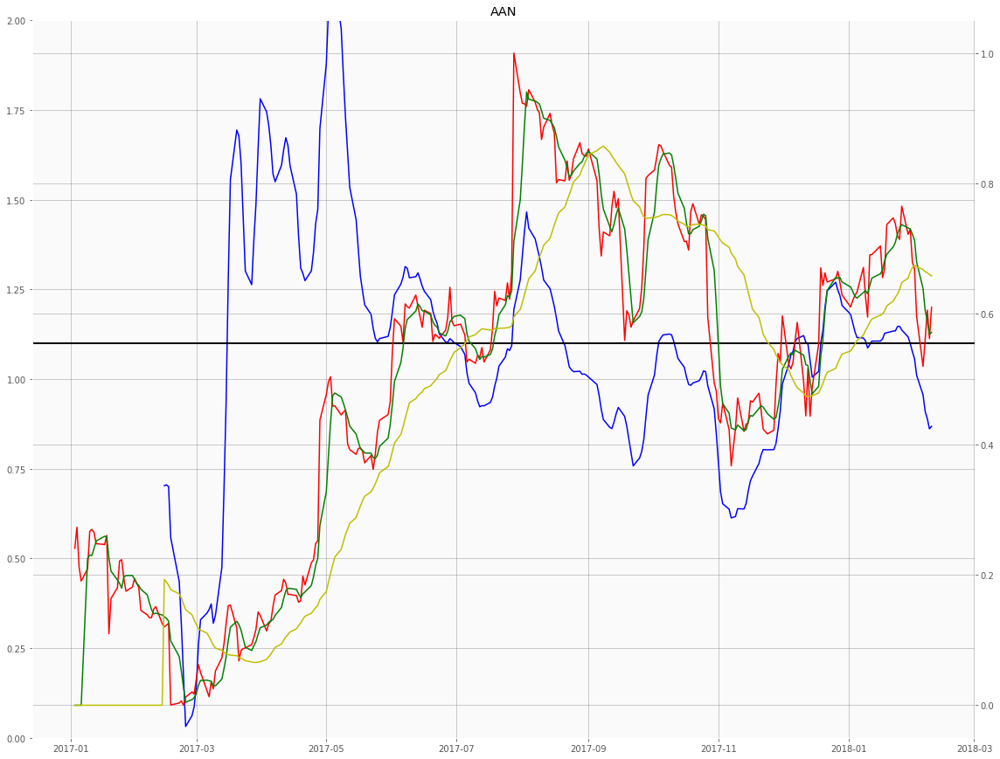

...

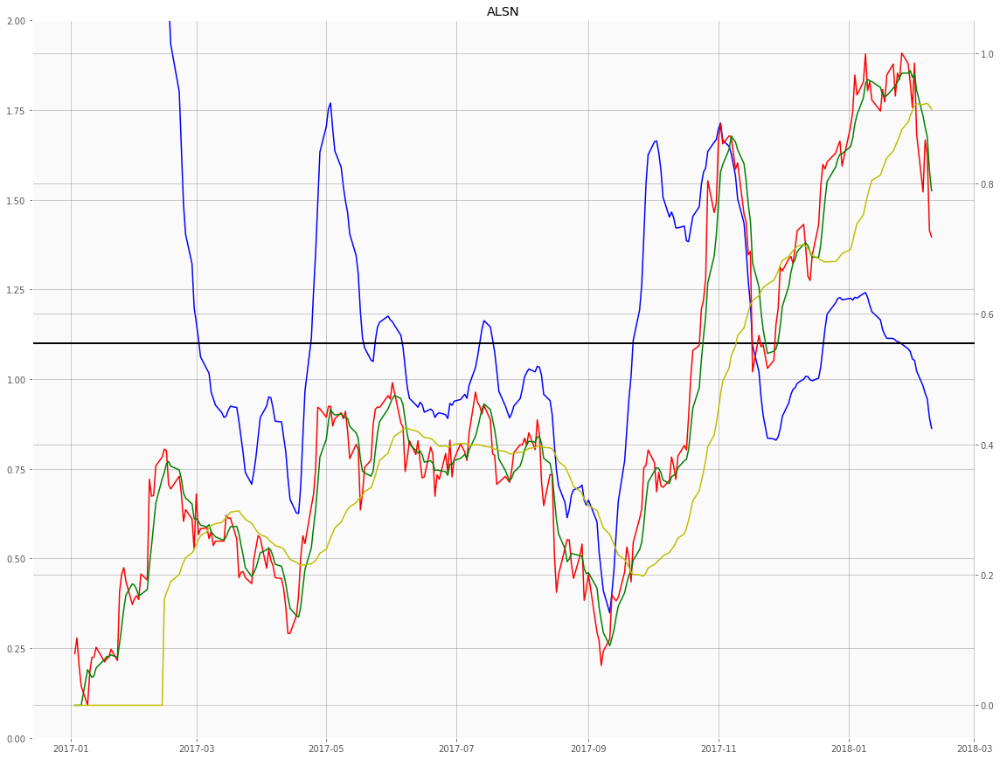

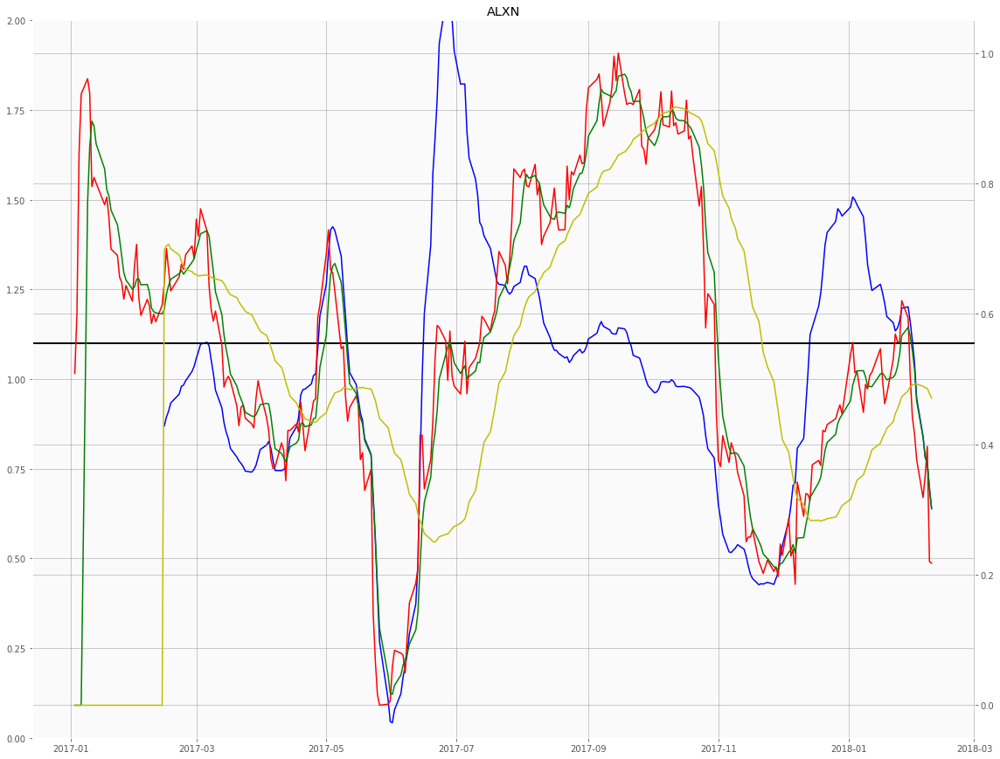

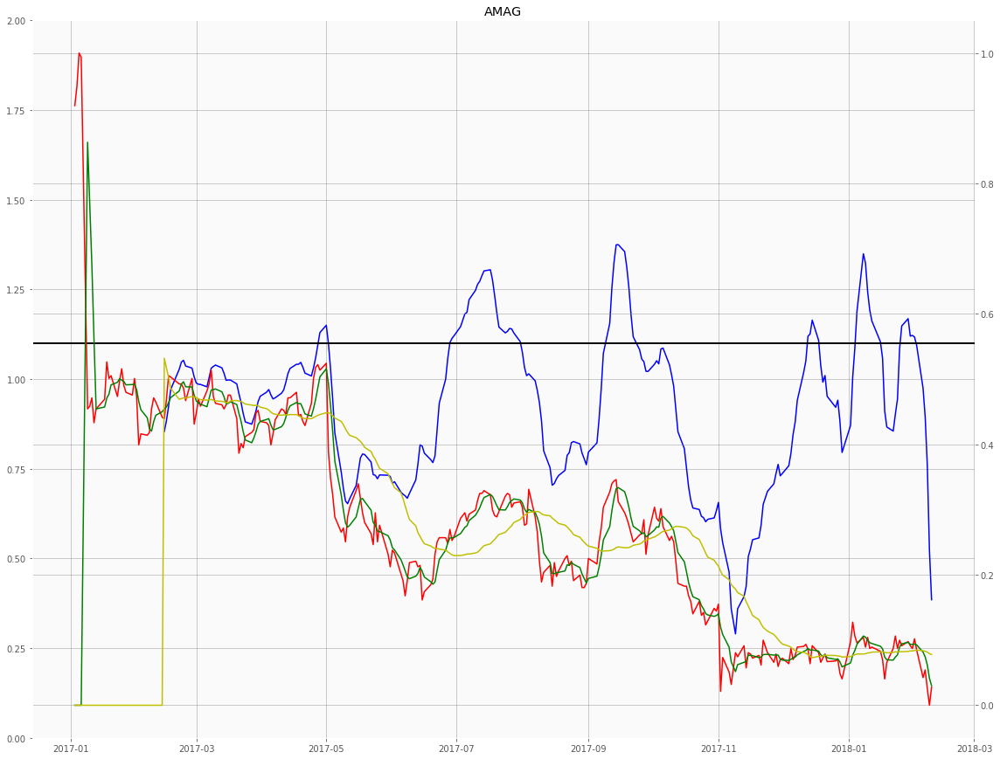

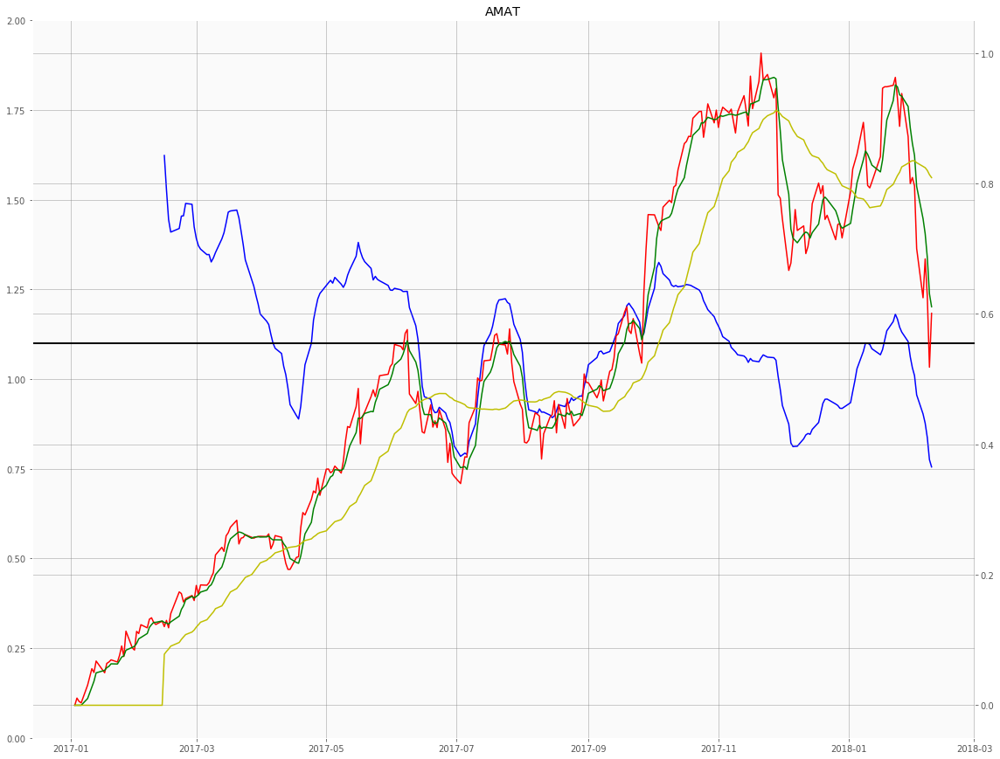

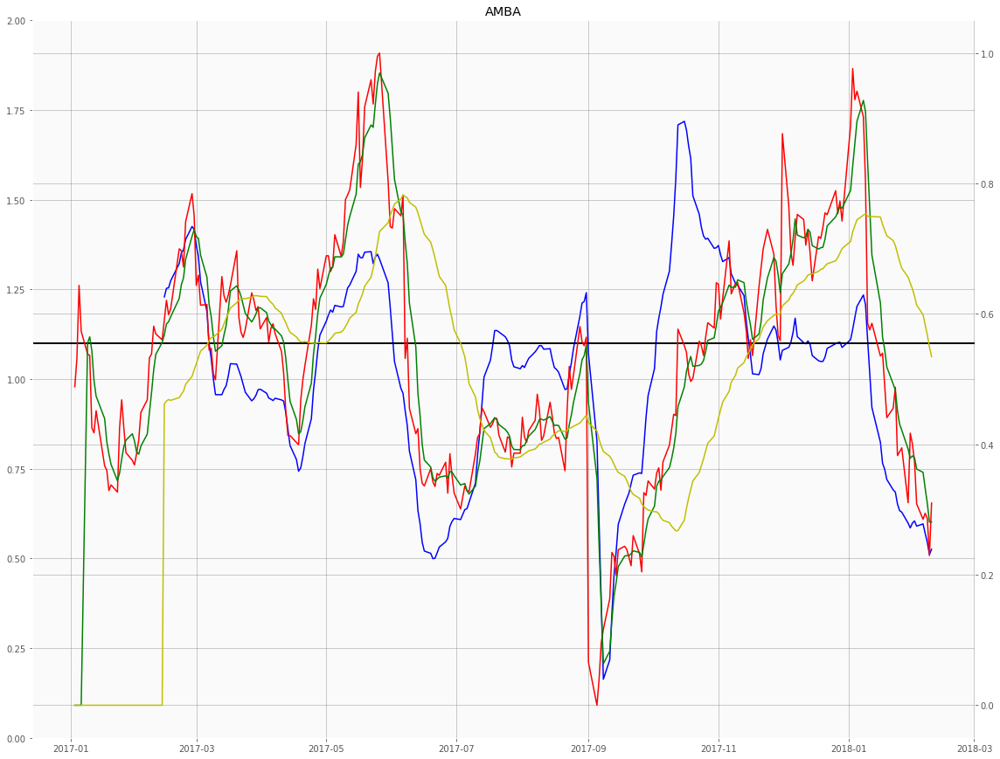

KeyboardInterrupt: 

In [133]:
for sym in all_sym_df.Symbol.unique():
    
    sym_df = all_sym_df.loc[all_sym_df.Symbol == sym]

    fig, ax1 = plt.subplots(figsize=(16,12))

    ax1.plot(sym_df.Date,sym_df['Diff'], 'b')
    ax1.set_ylim(0,2)
    ax2 = ax1.twinx()
    ax2.plot(sym_df.Date,sym_df['1mavg'],'r')
    ax2.plot(sym_df.Date,sym_df['5mavg'],'g')
    ax2.plot(sym_df.Date,sym_df['30mavg'],'y')
    ax1.axhline(1.1, c='black',lw = 2)
    fig.tight_layout()
    plt.title('{}'.format(sym))
    plt.show()

In [45]:
mini_df = W.History[W.History.Symbol.isin(['AAPL','CSCO','A','AA'])]

In [48]:
mini_df.Symbol

99234        A
99235        A
99236        A
99237        A
99238        A
99239        A
99240        A
99241        A
99242        A
99243        A
99244        A
99245        A
99246        A
99247        A
99248        A
99249        A
99250        A
99251        A
99252        A
99253        A
99254        A
99255        A
99256        A
99257        A
99258        A
99259        A
99260        A
99261        A
99262        A
99263        A
99264        A
99265        A
99266        A
99267        A
99268        A
99269        A
99270        A
99271        A
99272        A
99273        A
99274        A
99275        A
99276        A
99277        A
99278        A
99279        A
99280        A
99281        A
99282        A
99283        A
99284        A
99285        A
99286        A
99287        A
99288        A
99289        A
99290        A
99291        A
99292        A
99293        A
99294        A
99295        A
99296        A
99297        A
99298        A
99299        A
99300     

In [77]:
cols = ['Date']
for mavg in mavg_set:
    col = symbol + '-' + str(mavg) + 'mavg'
    cols.append(col)

In [108]:
cols

['Date', 'HAWK-1mavg', 'HAWK-10mavg', 'HAWK-30mavg']

In [122]:
mavg_sets =  [[1,10,30],[1,10,50],[1,30,50]]
hard_thresholds = [0.1,0.3,0.5,0.7]
minmax_thresholds = [0.1,0.15,0.2,0.25]
minmax_windows = [5,10,15]
results = []
for mavg_set in mavg_sets:
    datestart = min(norm_df.Date)


    dateend = (str((datetime.datetime.now().date().year))
              + '-' + str((datetime.datetime.now().date().month))
              + '-' + str((datetime.datetime.now().date().day)))
    
    maxs = W.History[['Symbol','Close']].groupby('Symbol').max()
    mins = W.History[['Symbol','Close']].groupby('Symbol').min()

    norm_df = W.History[['Symbol','Date','Close']]
    norm_df['NormPrice'] = norm_df[['Symbol','Close']].groupby('Symbol').transform(lambda x: (x - min(x)) / ( max(x) - min(x)))

    symbols = norm_df.Symbol.unique()

    mavg_dict = {'Date':norm_df[(norm_df['Date'] >= datestart) 
                                          & (norm_df['Date'] <= dateend)].Date.unique()}

    for symbol in symbols:

        for mavg in mavg_set:

            label = symbol + '-' + str(mavg) + 'mavg'

            mavg_dict[label] = norm_df[(norm_df['Symbol'] == symbol) &
                                         (norm_df['Date'] >= datestart) 
                                          & (norm_df['Date'] <= dateend)].NormPrice.rolling(window=mavg).mean().values

    norm_mavg_df = pd.DataFrame(mavg_dict)
    
    ######### Hard Threshold Runs #####################3
    for hard_threshold in hard_thresholds:
        start_time = time.time()

        threshold = hard_threshold
        headers = ['Date'] + ['mavg' + str(mavg) for mavg in mavg_set] + ['Symbol','Trend','Reversal','Return','Close']
        reversals = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                                headers[1]:'float64',
                                                                headers[2]:'float64',
                                                                headers[3]:'float64',
                                                                headers[4]:str,
                                                                headers[5]:int,
                                                                headers[6]:int,
                                                                headers[7]:'float64',
                                                                headers[8]:'float64'}, parse_date = 'Date')

        all_sym_df = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                                headers[1]:'float64',
                                                                headers[2]:'float64',
                                                                headers[3]:'float64',
                                                                headers[4]:str,
                                                                headers[5]:int,
                                                                headers[6]:int,
                                                                headers[7]:'float64',
                                                                headers[8]:'float64'}, parse_date = 'Date')


        for symbol in W.symbols:
            cols = ['Date']
            for mavg in mavg_set:
                col = symbol + '-' + str(mavg) + 'mavg'
                cols.append(col)

            sym_df = norm_mavg_df.loc[:,cols]
            sym_df = sym_df.fillna(0)
            sym_df = sym_df.assign(Symbol = symbol)
            sym_df = sym_df.assign(Trend = lambda x: x[cols[2]] < x[cols[3]])
            sym_df = sym_df*1
            sym_df = sym_df.assign(Reversal = 0)
            sym_df = sym_df.assign(Return = 0)

            sym_price = pd.DataFrame(W.History.loc[W.History.Symbol == symbol,['Symbol','Date','Close']])
            sym_df = sym_df.merge(sym_price, on = ['Date','Symbol'])

            sym_df.columns = headers
            sym_df = sym_df.assign(Diff = lambda x: x[headers[2]] - sym_df[headers[3]])


            sym_df.loc[(sym_df['Diff'] < threshold) & (sym_df['Diff'].shift(1) > threshold), 'Reversal'] = -1
            sym_df.loc[(sym_df['Diff'] > threshold) & (sym_df['Diff'].shift(1) < threshold), 'Reversal'] = 1



            rev_df = sym_df[sym_df['Reversal'] != 0]
            rev_df = rev_df.assign(Return = lambda x: x.Close - x.Close.shift(1))
            rev_df.loc[rev_df['Reversal'].shift(1) == -1,'Return'] = -rev_df['Return']
            rev_df = rev_df.assign(PriceNormalizedReturn = lambda x: x.Return/x.Close)

            reversals = pd.concat([reversals,rev_df], ignore_index = True)
            all_sym_df = pd.concat([all_sym_df,sym_df],ignore_index = True)

        total_return = reversals.PriceNormalizedReturn.sum()

        results.append([mavg_set,threshold,total_return])
        elapsed_time = time.time() - start_time
        print('{:.3f} seconds | mavg set: {}, hard thresh: {} ------- total return: {:.3f}'.format(elapsed_time,mavg_set, threshold, total_return))
        #gc.collect()
    ############ Flexible Threshold Runs #######################
    for thresh in minmax_thresholds:
        for win in minmax_windows:
            start_time = time.time()
            threshold = thresh
            rolling_days = win
            headers = ['Date'] + ['mavg' + str(mavg) for mavg in mavg_set] + ['Symbol','Trend','Reversal',
                                                                           'Return','Close']
            reversals = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                                    headers[1]:'float64',
                                                                    headers[2]:'float64',
                                                                    headers[3]:'float64',
                                                                    headers[4]:str,
                                                                    headers[5]:int,
                                                                    headers[6]:int,
                                                                    headers[7]:'float64',
                                                                    headers[8]:'float64',}, parse_date = 'Date')

            all_sym_df = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                                    headers[1]:'float64',
                                                                    headers[2]:'float64',
                                                                    headers[3]:'float64',
                                                                    headers[4]:str,
                                                                    headers[5]:int,
                                                                    headers[6]:int,
                                                                    headers[7]:'float64',
                                                                    headers[8]:'float64',}, parse_date = 'Date')


            for symbol in W.symbols:
                cols = ['Date']
                for mavg in mavg_set:
                    col = symbol + '-' + str(mavg) + 'mavg'
                    cols.append(col)

                sym_df = norm_mavg_df.loc[:,cols]
                sym_df = sym_df.fillna(0)
                sym_df = sym_df.assign(Symbol = symbol)
                sym_df = sym_df.assign(Trend = lambda x: x[cols[2]] < x[cols[3]])
                sym_df = sym_df*1
                sym_df = sym_df.assign(Reversal = 0)
                sym_df = sym_df.assign(Return = 0)

                sym_price = pd.DataFrame(W.History.loc[W.History.Symbol == symbol,['Symbol','Date','Close']])
                sym_df = sym_df.merge(sym_price, on = ['Date','Symbol'])



                sym_df.columns = headers
                sym_df = sym_df.assign(Diff = lambda x: x[headers[2]] - sym_df[headers[3]])

                sym_df['RollingDiffMin'] = sym_df.Diff.rolling(rolling_days).min()
                sym_df['RollingDiffMax'] = sym_df.Diff.rolling(rolling_days).max()

                sym_df.loc[(sym_df['RollingDiffMax'] - sym_df['Diff']  > threshold) 
                           & (sym_df['RollingDiffMax'] - sym_df['Diff'].shift(1) < threshold), 'Reversal'] = -1
                sym_df.loc[(sym_df['Diff'] - sym_df['RollingDiffMin'] > threshold) 
                           & (sym_df['Diff'].shift(1) - sym_df['RollingDiffMin'] < threshold), 'Reversal'] = 1



                rev_df = sym_df[sym_df['Reversal'] != 0]
                rev_df = rev_df.assign(Return = lambda x: x.Close - x.Close.shift(1))
                rev_df.loc[rev_df['Reversal'].shift(1) == -1,'Return'] = -rev_df['Return']
                rev_df = rev_df.assign(PriceNormalizedReturn = lambda x: x.Return/x.Close)
                


                reversals = pd.concat([reversals,rev_df], ignore_index = True)
                all_sym_df = pd.concat([all_sym_df,sym_df],ignore_index = True)
                
            total_return = reversals.PriceNormalizedReturn.sum()
            results.append([mavg_set,thresh, win,total_return])
            elapsed_time = time.time() - start_time
            print('{:.3f} seconds | mavg set: {}, rolling_minmax_window: {}, soft thresh: {} ------- total return: {:.3f}'.format(elapsed_time,mavg_set, win, thresh, total_return))
            #gc.collect()

C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


113.373 seconds | mavg set: [1, 10, 30], hard thresh: 0.1 ------- total return: -242.336
114.804 seconds | mavg set: [1, 10, 30], hard thresh: 0.3 ------- total return: -22.584
114.165 seconds | mavg set: [1, 10, 30], hard thresh: 0.5 ------- total return: -8.066
114.290 seconds | mavg set: [1, 10, 30], hard thresh: 0.7 ------- total return: -13.765
128.331 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 5, soft thresh: 0.1 ------- total return: 18.420
127.982 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 10, soft thresh: 0.1 ------- total return: -11.908
127.545 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 15, soft thresh: 0.1 ------- total return: -49.957
128.341 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 5, soft thresh: 0.15 ------- total return: 17.853
127.637 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 10, soft thresh: 0.15 ------- total return: 29.335
128.606 seconds | mavg set: [1, 10, 30], rolling_minmax_window: 15, soft thr

In [119]:
sym_df[sym_df['Reversal'] != 0]

,Date,mavg1,mavg10,mavg30,Symbol,Trend,Reversal,Return,Close,Diff


In [121]:
threshold

1.3

In [120]:
sym_df.loc[(sym_df['Diff'] < threshold) & (sym_df['Diff'].shift(1) > threshold), 'Reversal']

Series([], Name: Reversal, dtype: int64)

In [118]:
sym_df.loc[(sym_df['Diff'] < threshold) & (sym_df['Diff'].shift(1) > threshold), 'Reversal'] = -1
            sym_df.loc[(sym_df['Diff'] > threshold) & (sym_df['Diff'].shift(1) < threshold), 'Reversal'] = 1

,Date,mavg1,mavg10,mavg30,Symbol,Trend,Reversal,Return,Close,Diff
0,2017-01-03,0.3801,0.0000,0.0000,CYS,0,0,0,7.2633,0.0000
1,2017-01-04,0.3840,0.0000,0.0000,CYS,0,0,0,7.2724,0.0000
2,2017-01-05,0.3996,0.0000,0.0000,CYS,0,0,0,7.3090,0.0000
3,2017-01-06,0.3723,0.0000,0.0000,CYS,0,0,0,7.2450,0.0000
4,2017-01-09,0.3606,0.0000,0.0000,CYS,0,0,0,7.2175,0.0000
5,2017-01-10,0.3645,0.0000,0.0000,CYS,0,0,0,7.2267,0.0000
6,2017-01-11,0.3840,0.0000,0.0000,CYS,0,0,0,7.2724,0.0000
7,2017-01-12,0.3606,0.0000,0.0000,CYS,0,0,0,7.2175,0.0000
8,2017-01-13,0.3723,0.0000,0.0000,CYS,0,0,0,7.2450,0.0000
9,2017-01-17,0.3918,0.3770,0.0000,CYS,0,0,0,7.2907,0.3770


In [101]:
 sym_df.loc[(sym_df['Diff'] < threshold) & (sym_df['Diff'].shift(1) > threshold), 'Reversal']

KeyError: 'Diff'

In [96]:
rev_df.assign(Return = lambda x: x.Close - x.Close.shift(1))

,Date,mavg1,mavg10,mavg30,Symbol,Trend,Reversal,Return,Close,Diff,PriceNormalizedReturn


In [100]:
sym_df

,Date,HAWK-1mavg,HAWK-10mavg,HAWK-30mavg,Symbol,Trend,Reversal,Return
0,2017-01-03,0.3633,0.0000,0.0000,HAWK,0,0,0
1,2017-01-04,0.4173,0.0000,0.0000,HAWK,0,0,0
2,2017-01-05,0.3741,0.0000,0.0000,HAWK,0,0,0
3,2017-01-06,0.3597,0.0000,0.0000,HAWK,0,0,0
4,2017-01-09,0.3417,0.0000,0.0000,HAWK,0,0,0
5,2017-01-10,0.2950,0.0000,0.0000,HAWK,0,0,0
6,2017-01-11,0.2914,0.0000,0.0000,HAWK,0,0,0
7,2017-01-12,0.2986,0.0000,0.0000,HAWK,0,0,0
8,2017-01-13,0.3237,0.0000,0.0000,HAWK,0,0,0
9,2017-01-17,0.2410,0.3306,0.0000,HAWK,0,0,0


In [84]:
cols

['Date', 'A-1mavg']

In [71]:
sym_df.assign(Diffe = lambda x: x[headers[2]] - sym_df[headers[3]])

,Date,mavg1,mavg30,mavg50,Symbol,Trend,Reversal,Return,Close,Diff,RollingDiffMin,RollingDiffMax,Diffe
0,2017-01-03,0.0213,0.0000,0.0000,CSCO,0,0,0,29.4850,0.0000,nan,nan,0.0000
1,2017-01-04,0.0086,0.0000,0.0000,CSCO,0,0,0,29.3112,0.0000,nan,nan,0.0000
2,2017-01-05,0.0135,0.0000,0.0000,CSCO,0,0,0,29.3793,0.0000,nan,nan,0.0000
3,2017-01-06,0.0178,0.0000,0.0000,CSCO,0,0,0,29.4378,0.0000,nan,nan,0.0000
4,2017-01-09,0.0143,0.0000,0.0000,CSCO,0,0,0,29.3891,0.0000,nan,nan,0.0000
5,2017-01-10,0.0285,0.0000,0.0000,CSCO,0,0,0,29.5838,0.0000,nan,nan,0.0000
6,2017-01-11,0.0121,0.0000,0.0000,CSCO,0,0,0,29.3599,0.0000,nan,nan,0.0000
7,2017-01-12,0.0043,0.0000,0.0000,CSCO,0,0,0,29.2528,0.0000,nan,nan,0.0000
8,2017-01-13,0.0064,0.0000,0.0000,CSCO,0,0,0,29.2820,0.0000,nan,nan,0.0000
9,2017-01-17,0.0007,0.0000,0.0000,CSCO,0,0,0,29.2041,0.0000,nan,nan,0.0000


In [55]:
reversals.Return / reversals.Close

C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [60]:
rev_df

,Date,mavg1,mavg30,mavg50,Symbol,Trend,Reversal,Return,Close,Diff,RollingDiffMin,RollingDiffMax,PriceNormalizedReturn
64,2017-04-05,0.2358,0.2908,0.2273,CSCO,0,-1,nan,32.4141,1.2792,1.2792,1.5555,0
123,2017-06-28,0.1696,0.1461,0.2032,CSCO,1,-1,0.9037,31.5105,0.7188,0.7188,0.9766,0
124,2017-06-29,0.1214,0.1403,0.2014,CSCO,1,-1,0.6581,30.8523,0.6964,0.6964,0.9642,0
142,2017-07-26,0.1606,0.1450,0.1473,CSCO,1,1,-0.5354,31.3878,0.9843,0.7235,0.9843,0


In [67]:
rev_df.assign(newcol = lambda x: x.Return/x.Close)

,Date,mavg1,mavg30,mavg50,Symbol,Trend,Reversal,Return,Close,Diff,RollingDiffMin,RollingDiffMax,PriceNormalizedReturn,newcol
64,2017-04-05,0.2358,0.2908,0.2273,CSCO,0,-1,nan,32.4141,1.2792,1.2792,1.5555,0,nan
123,2017-06-28,0.1696,0.1461,0.2032,CSCO,1,-1,0.9037,31.5105,0.7188,0.7188,0.9766,0,0.0287
124,2017-06-29,0.1214,0.1403,0.2014,CSCO,1,-1,0.6581,30.8523,0.6964,0.6964,0.9642,0,0.0213
142,2017-07-26,0.1606,0.1450,0.1473,CSCO,1,1,-0.5354,31.3878,0.9843,0.7235,0.9843,0,-0.0171


In [59]:
reversals.Return / reversals.Close

0       nan
1       nan
2    0.0025
3       nan
4    0.0287
5    0.0213
6   -0.0171
dtype: float64

In [17]:
threshold = 0.1
rolling_days = 10
headers = ['Date'] + ['mavg' + str(win) for win in windows] + ['Symbol','Trend','Reversal',
                                                               'Return','Close']
reversals = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64',
                                                        headers[8]:'float64',}, parse_date = 'Date')

all_sym_df = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64',
                                                        headers[8]:'float64',}, parse_date = 'Date')


for symbol in W.symbols:
    cols = ['Date']
    for window in windows:
        col = symbol + '-' + str(window) + 'mavg'
        cols.append(col)
        
    sym_df = norm_mavg_df.loc[:,cols]
    sym_df = sym_df.fillna(0)
    sym_df['Symbol'] = symbol
    sym_df['Trend'] = sym_df[cols[2]] < sym_df[cols[3]]
    sym_df = sym_df*1
    sym_df['Reversal'] = 0
    sym_df['Return'] = 0
    
    sym_price = pd.DataFrame(W.History.loc[W.History.Symbol == symbol,['Symbol','Date','Close']])
    sym_df = sym_df.merge(sym_price, on = ['Date','Symbol'])
    

    
    sym_df.columns = headers
    sym_df['Diff'] = sym_df[headers[2]] / sym_df[headers[3]]
    
    sym_df['RollingDiffMin'] = sym_df.Diff.rolling(rolling_days).min()
    sym_df['RollingDiffMax'] = sym_df.Diff.rolling(rolling_days).max()
    
    sym_df.loc[(sym_df['RollingDiffMax'] - sym_df['Diff']  > threshold) 
               & (sym_df['RollingDiffMax'] - sym_df['Diff'].shift(1) < threshold), 'Reversal'] = -1
    sym_df.loc[(sym_df['Diff'] - sym_df['RollingDiffMin'] > threshold) 
               & (sym_df['Diff'].shift(1) - sym_df['RollingDiffMin'] < threshold), 'Reversal'] = 1
    
    
    
    rev_df = sym_df[sym_df['Reversal'] != 0]
    rev_df['Return'] = rev_df.Close - rev_df.Close.shift(1)
    rev_df.loc[rev_df['Reversal'].shift(1) == -1,'Return'] = -rev_df['Return']
    rev_df['PriceNormalizedReturn'] = reversals.Return / reversals.Close
    
    
    reversals = pd.concat([reversals,rev_df], ignore_index = True)
    all_sym_df = pd.concat([all_sym_df,sym_df],ignore_index = True)

SyntaxError: invalid syntax (<ipython-input-17-dac18cba9f3b>, line 3)

In [241]:
reversals = pd.concat([reversals,rev_df], ignore_index = True)

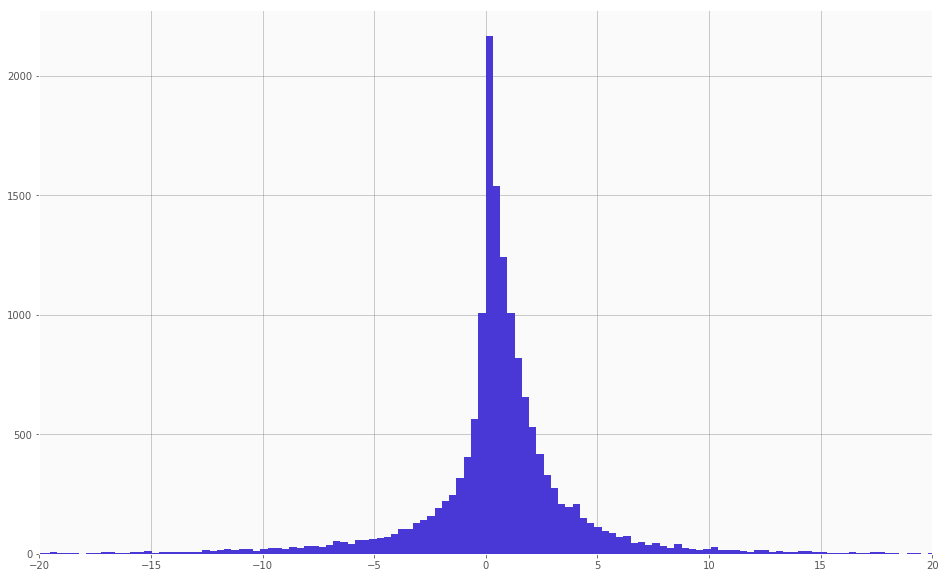

In [262]:
reversals.Return.hist(bins = 1000, figsize = (16,10), color = W.colors[1])
plt.xlim(-20,20)
plt.show()

In [269]:
buy_dates = sym_df[sym_df.Reversal == 1].Date
sell_dates = sym_df[sym_df.Reversal == -1].Date

In [271]:
sym_df[sym_df.Date.isin(buy_dates)].Close

6477   12.8150
6528   12.8919
6568   13.0852
6602   13.0950
6643   13.4400
6658   13.4800
6684   13.2000
Name: Close, dtype: float64

In [273]:
buy_dates

9843    2017-04-25
9870    2017-06-02
9903    2017-07-20
9936    2017-09-06
9940    2017-09-12
9952    2017-09-28
10027   2018-01-18
Name: Date, dtype: datetime64[ns]

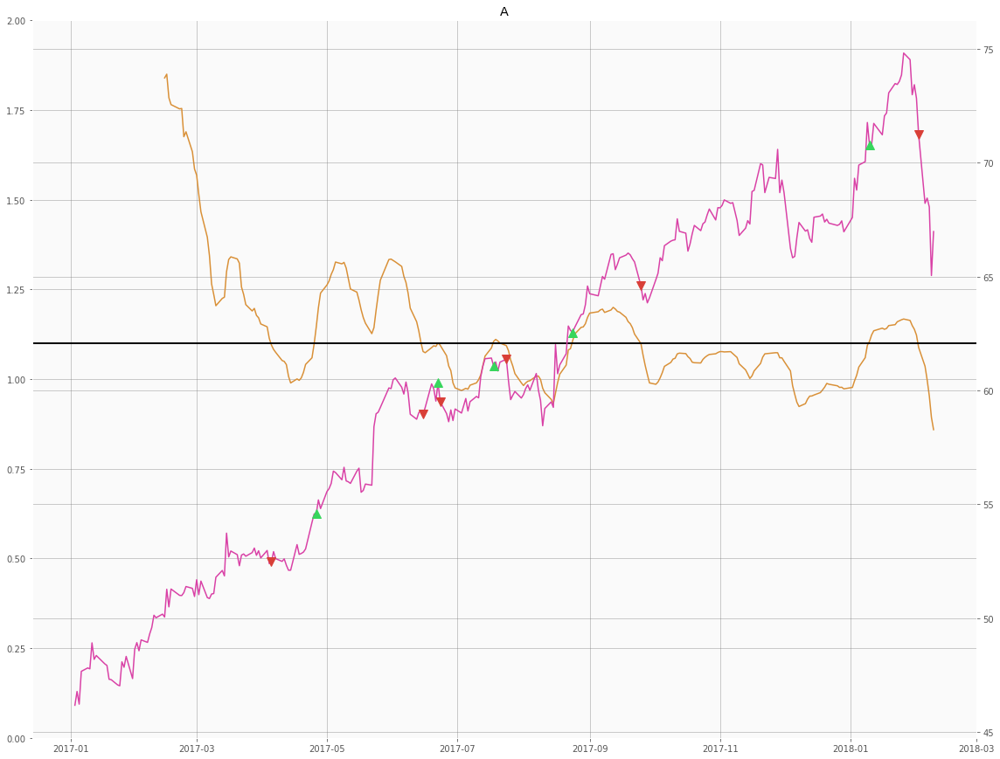

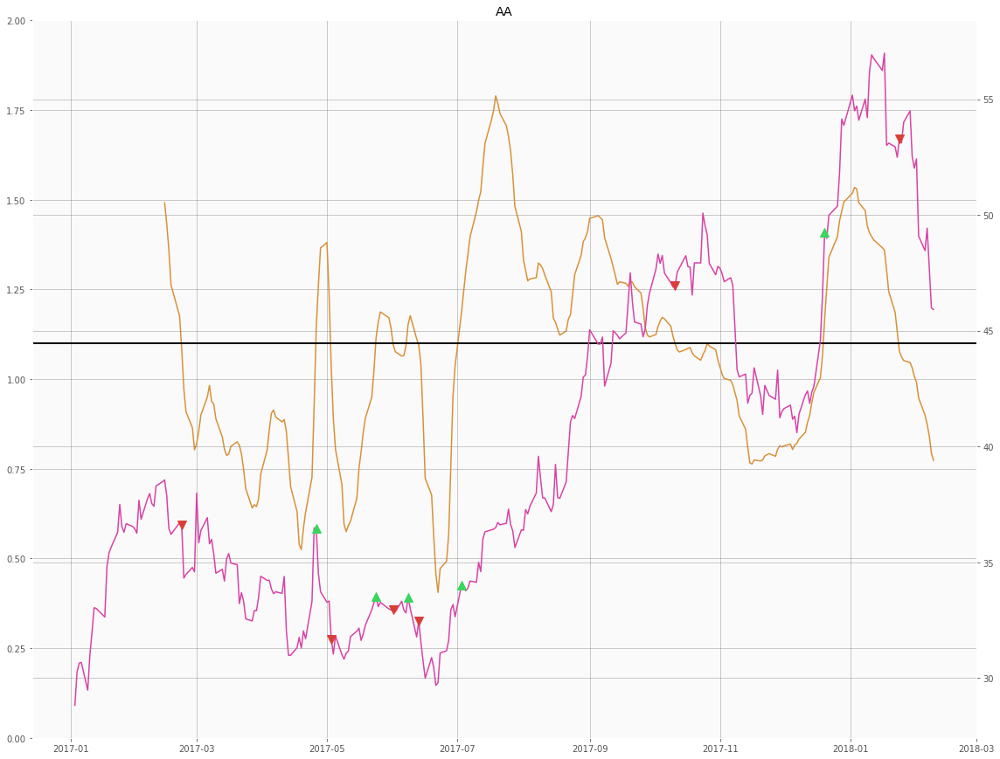

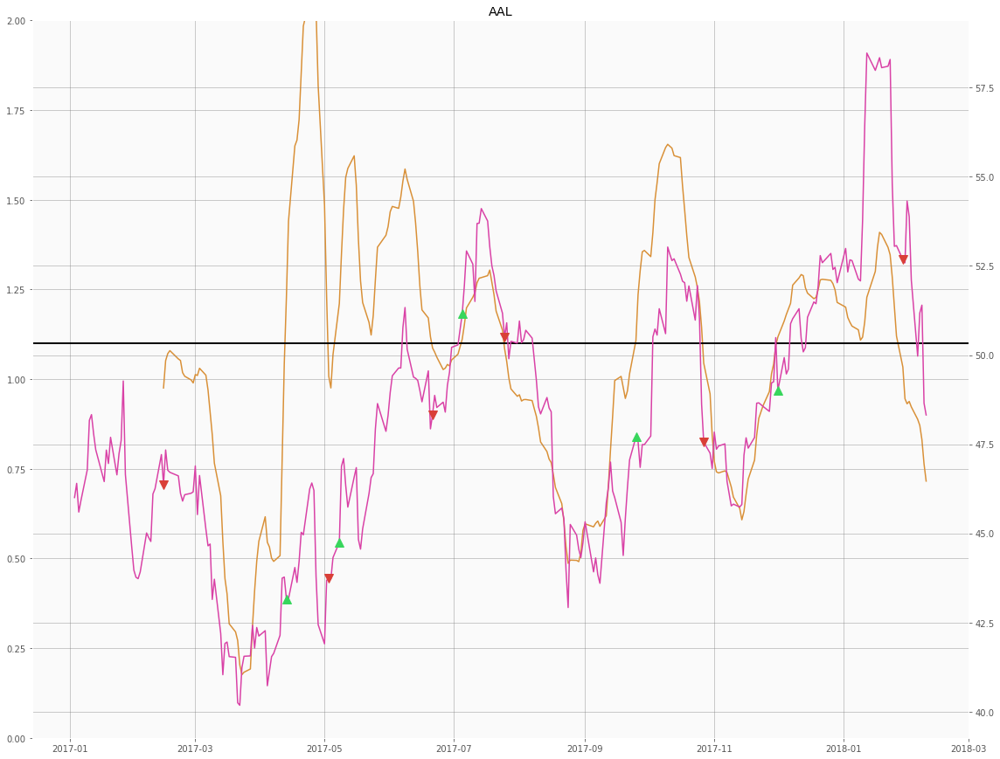

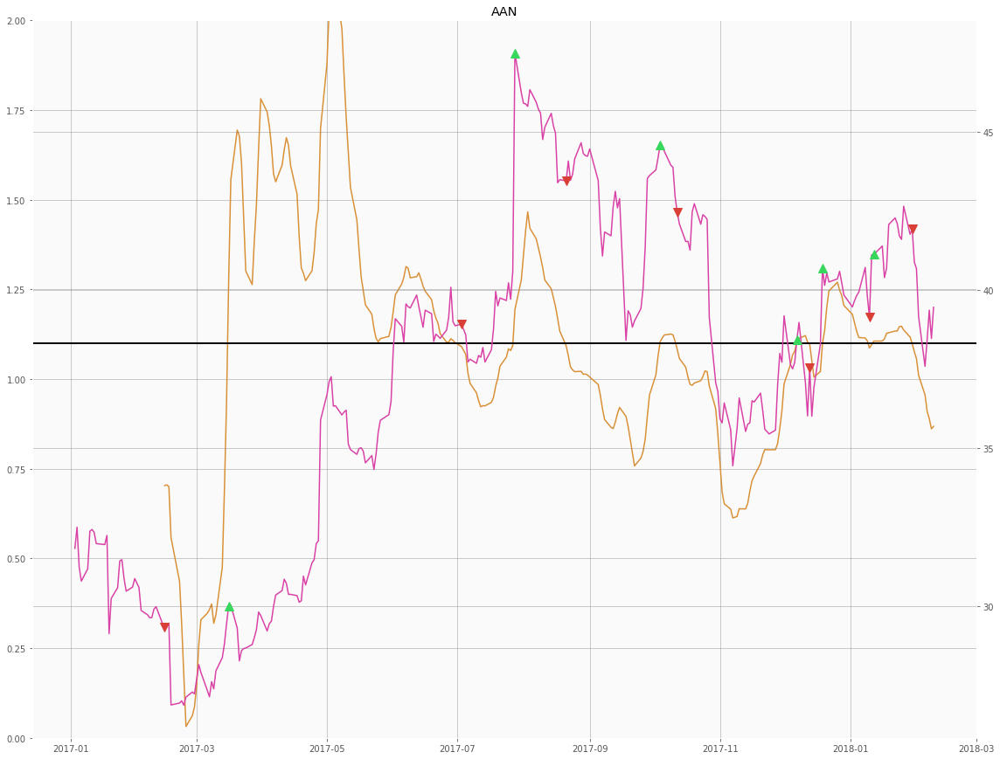

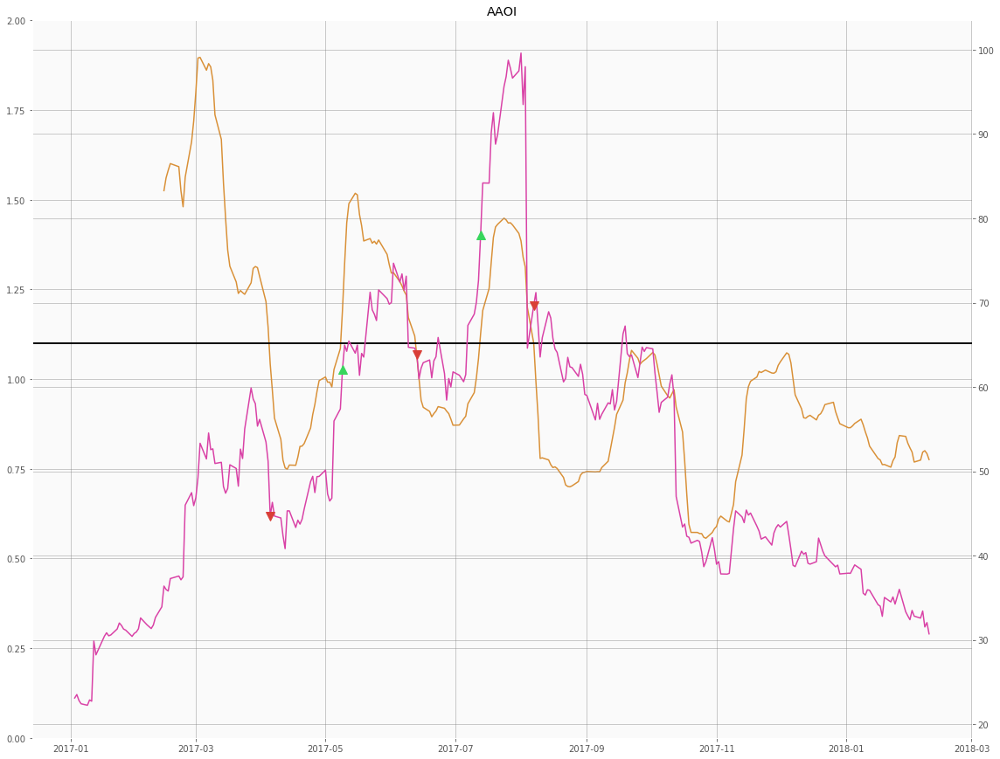

...

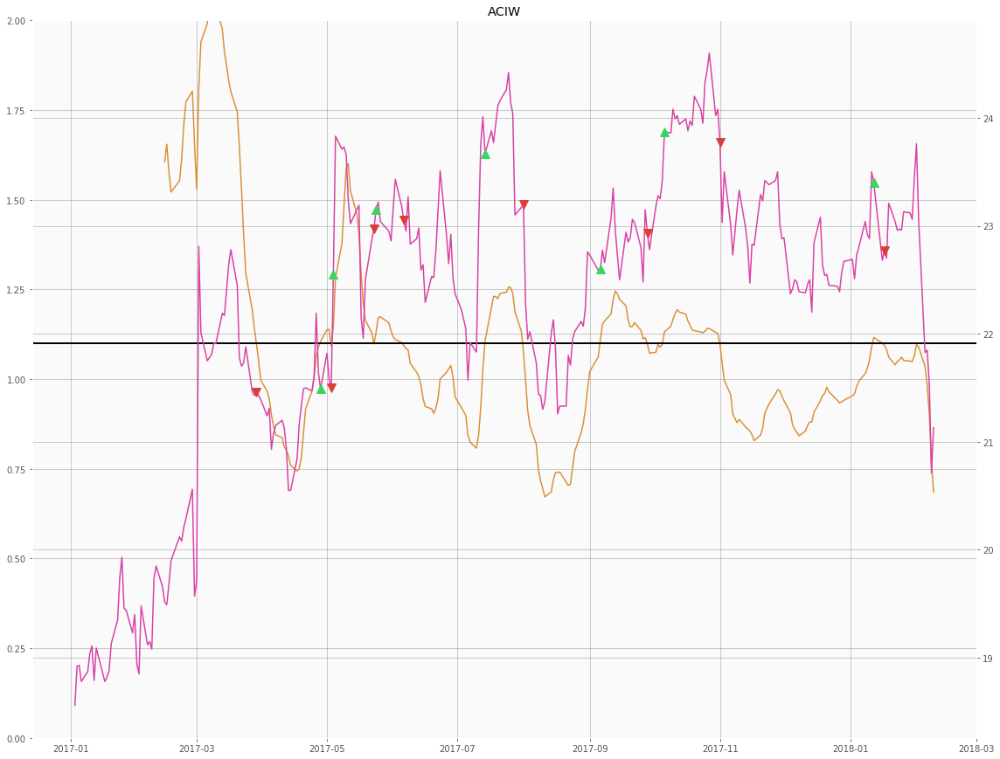

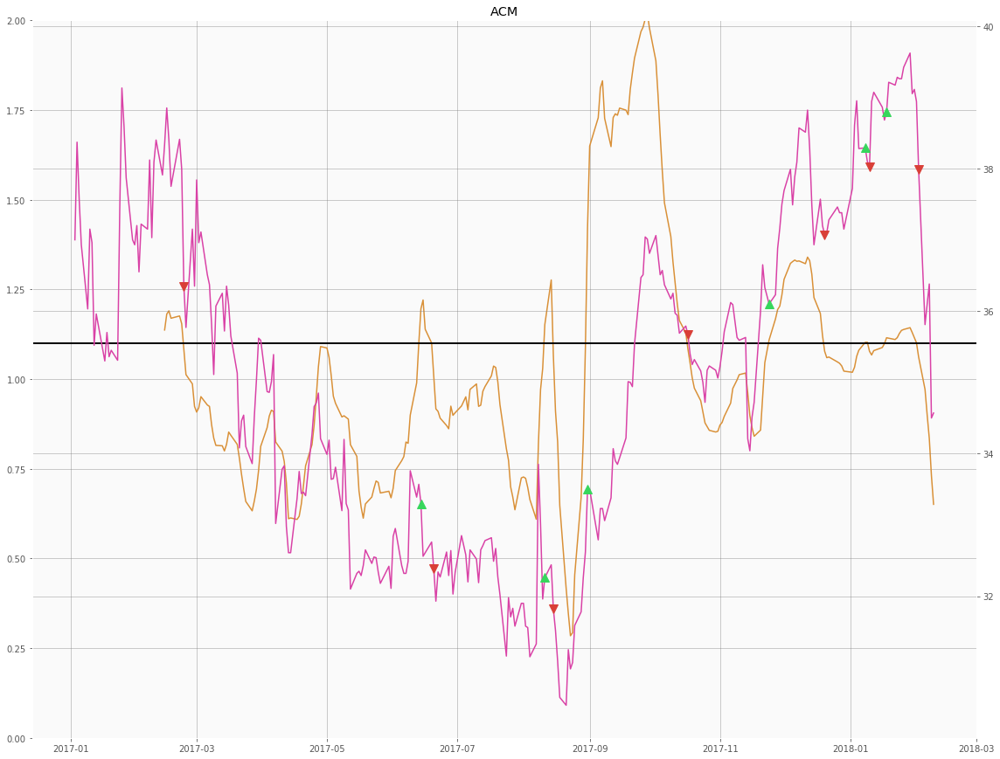

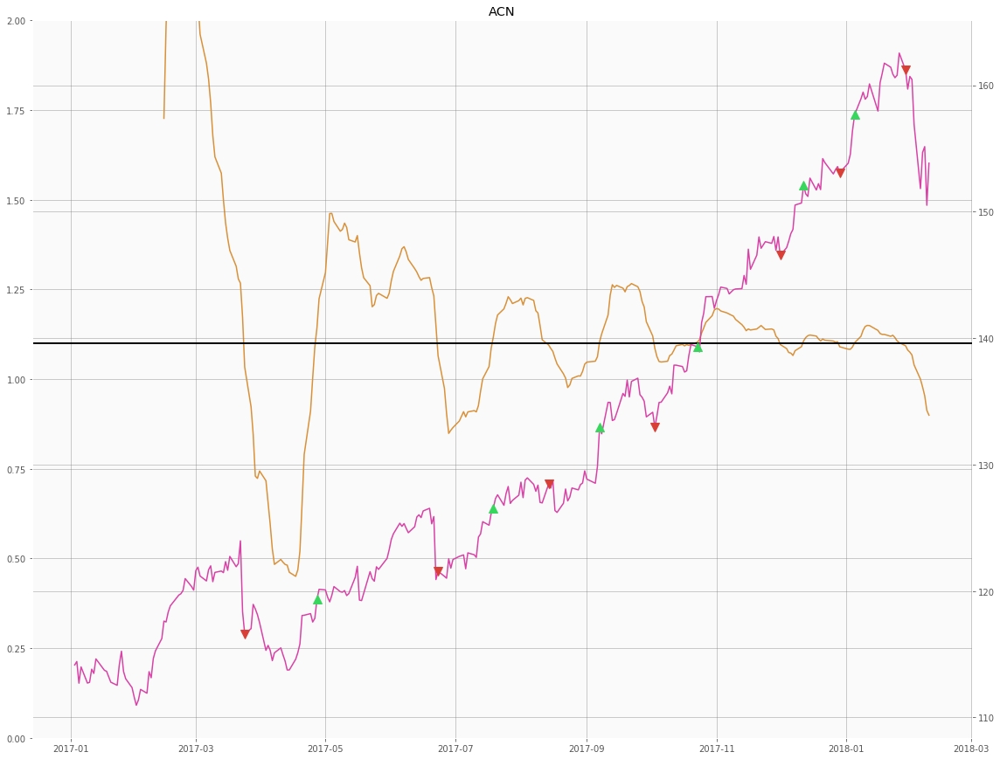

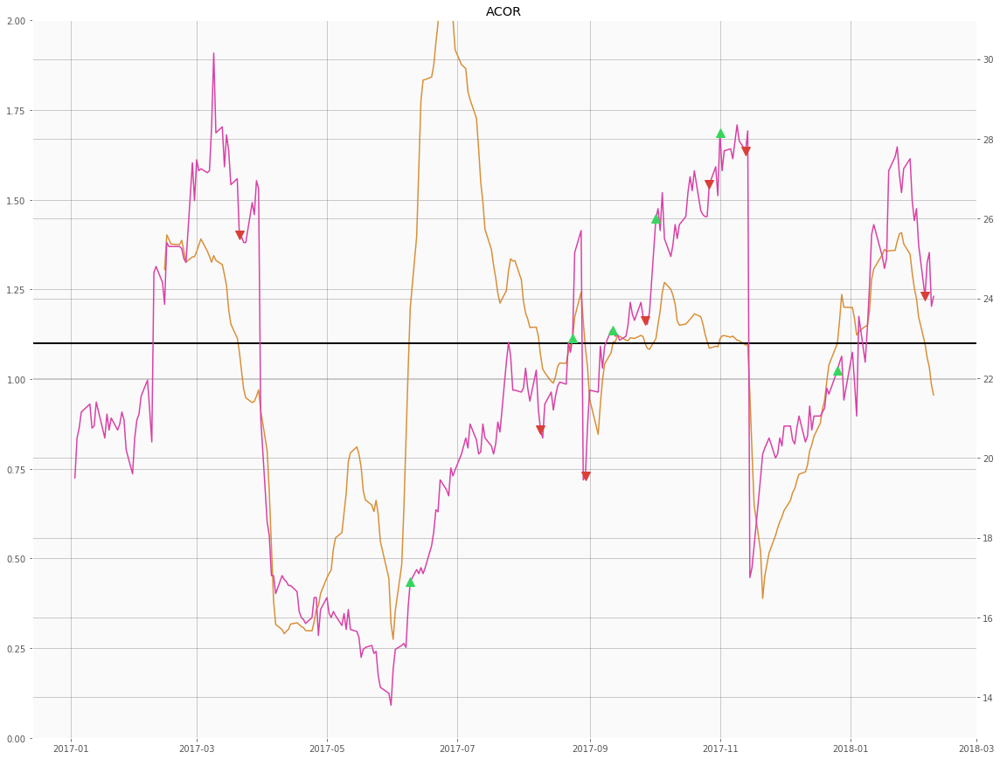

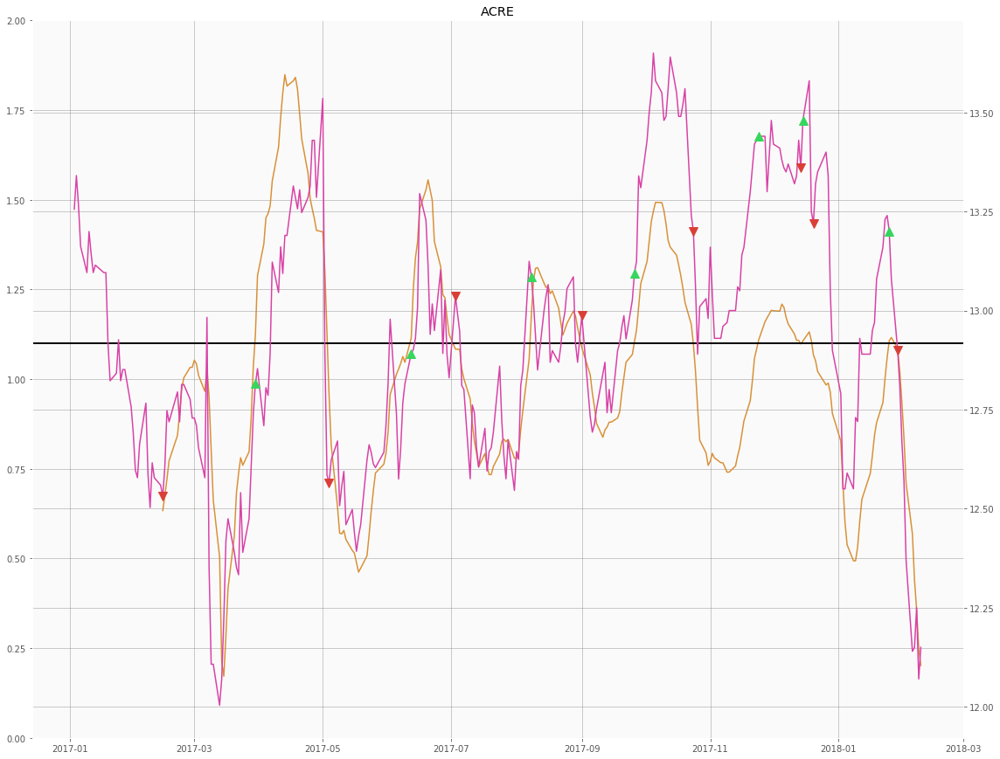

KeyboardInterrupt: 

In [286]:
for sym in all_sym_df.Symbol.unique():
    
    sym_df = all_sym_df.loc[all_sym_df.Symbol == sym]
    fig, ax1 = plt.subplots(figsize=(16,12))
    
    buy_dates = sym_df[sym_df.Reversal == 1].Date
    sell_dates = sym_df[sym_df.Reversal == -1].Date
    
    buy_prices = sym_df[sym_df.Date.isin(buy_dates)].Close
    sell_prices = sym_df[sym_df.Date.isin(sell_dates)].Close
    
    
    ax1.plot(sym_df.Date,sym_df['Diff'], color = W.colors[3])
    ax1.set_ylim(0,2)
    ax2 = ax1.twinx()
    ax2.plot(sym_df.Date,sym_df['Close'],color = W.colors[4])
    ax2.plot(buy_dates, buy_prices, linestyle = 'None', marker = '^', ms = 10, color = W.colors[2])
    ax2.plot(sell_dates, sell_prices, linestyle = 'None', marker = 'v', ms = 10, color = W.colors[0])
    
    ax1.axhline(1.1, c='black',lw = 2)
    
    fig.tight_layout()
    plt.title('{}'.format(sym))
    plt.show()

In [297]:
rev1 = reversals

In [298]:
rev1['PriceNormalizedReturn'] = reversals.Return / reversals.Close

In [300]:
rev1.PriceNormalizedReturn.sum()

11.246814596079817

In [303]:
rev1[['Symbol','PriceNormalizedReturn']].sort_values(by='PriceNormalizedReturn',ascending=False)

,Symbol,PriceNormalizedReturn
6739,GNCA,3.3200
4132,CVO,3.0208
11404,OCN,1.1807
1768,BCEI,0.9452
11488,OHRP,0.9018
2257,BPTH,0.8968
285,ACRX,0.8353
4021,CUR,0.6978
1401,ATRS,0.6372
17158,ZGNX,0.6248


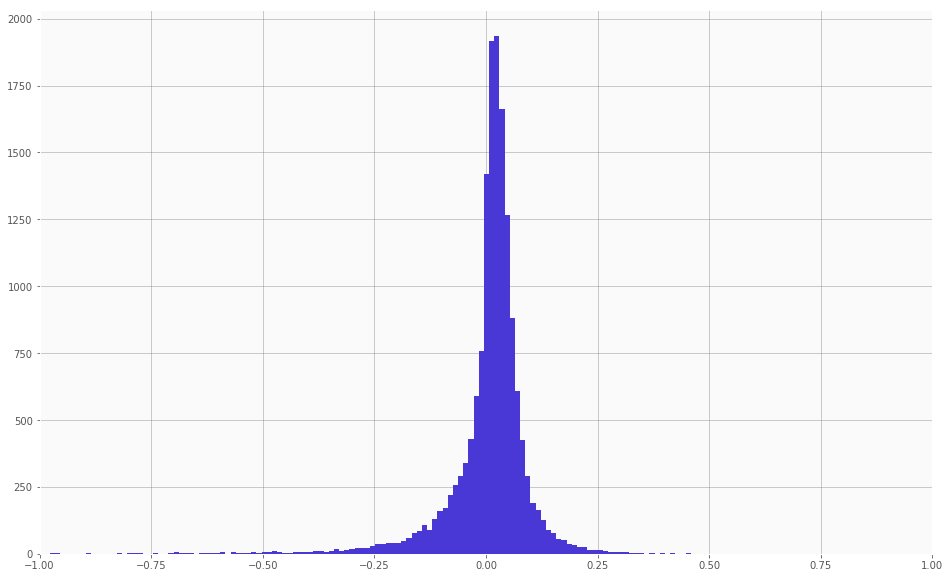

In [311]:
rev1.PriceNormalizedReturn.hist(bins = 1000, figsize = (16,10), color = W.colors[1])
plt.xlim(-1,1)
plt.show()

In [308]:
rev1

,Close,Date,Diff,Return,Reversal,Symbol,Trend,mavg1,mavg30,mavg5,PriceNormalizedReturn
0,52.4851,2017-04-05,1.0952,nan,-1,A,0,0.2202,0.2077,0.2275,nan
1,54.5961,2017-04-26,1.1457,2.1110,1,A,0,0.2939,0.2343,0.2684,0.0387
2,58.9574,2017-06-15,1.0771,-4.3613,-1,A,0,0.4462,0.4144,0.4463,-0.0740
3,60.3514,2017-06-22,1.1009,1.3940,1,A,0,0.4949,0.4352,0.4792,0.0231
4,59.5150,2017-06-23,1.0947,0.8364,-1,A,0,0.4657,0.4393,0.4810,0.0141
5,61.0857,2017-07-18,1.1051,1.5707,1,A,0,0.5205,0.4719,0.5216,0.0257
6,61.3751,2017-07-24,1.0934,-0.2894,-1,A,0,0.5306,0.4785,0.5232,-0.0047
7,62.5527,2017-08-24,1.1065,1.1776,1,A,0,0.5717,0.5041,0.5578,0.0188
8,64.5986,2017-09-25,1.0990,-2.0458,-1,A,0,0.6432,0.6171,0.6783,-0.0317
9,70.7900,2018-01-10,1.1053,6.1914,1,A,0,0.8593,0.7607,0.8409,0.0875


In [364]:
rev1.PriceNormalizedReturn.sum()

11.246814596079817

In [315]:
buy_ts = np.arange(1,1.1,0.01)

1.1

In [339]:
threshold = 1.4
all_sym_df[(all_sym_df.Diff > threshold) & (all_sym_df['Diff'].shift(1) < threshold)]

,Close,Date,Diff,Return,Reversal,Symbol,Trend,mavg1,mavg30,mavg5
409,34.1400,2017-07-10,1.4672,0.0000,0,AA,0,0.1886,0.1252,0.1837
447,43.8800,2017-08-31,1.4116,0.0000,0,AA,0,0.5344,0.3482,0.4915
527,51.8400,2017-12-27,1.4420,0.0000,0,AA,0,0.8171,0.5236,0.7550
629,43.1667,2017-04-14,1.4406,0.0000,0,AAL,0,0.1633,0.1146,0.1651
647,47.1000,2017-05-10,1.4724,0.0000,0,AAL,0,0.3784,0.1922,0.2830
660,47.8614,2017-05-30,1.4012,0.0000,0,AAL,0,0.4200,0.2869,0.4020
748,50.5100,2017-10-03,1.4084,0.0000,0,AAL,0,0.5648,0.3041,0.4283
820,58.3400,2018-01-18,1.4092,0.0000,0,AAL,0,0.9929,0.6865,0.9675
888,30.0299,2017-03-17,1.5562,0.0000,0,AAN,0,0.1536,0.0769,0.1196
896,29.2609,2017-03-29,1.4879,0.0000,0,AAN,0,0.1163,0.0656,0.0976


In [325]:
reversals[reversals.Diff > 1.1]

,Close,Date,Diff,Return,Reversal,Symbol,Trend,mavg1,mavg30,mavg5,PriceNormalizedReturn
1,54.5961,2017-04-26,1.1457,2.1110,1,A,0,0.2939,0.2343,0.2684,0.0387
3,60.3514,2017-06-22,1.1009,1.3940,1,A,0,0.4949,0.4352,0.4792,0.0231
5,61.0857,2017-07-18,1.1051,1.5707,1,A,0,0.5205,0.4719,0.5216,0.0257
7,62.5527,2017-08-24,1.1065,1.1776,1,A,0,0.5717,0.5041,0.5578,0.0188
9,70.7900,2018-01-10,1.1053,6.1914,1,A,0,0.8593,0.7607,0.8409,0.0875
12,36.4500,2017-04-26,1.1447,-0.1500,1,AA,0,0.2706,0.1603,0.1835,-0.0041
14,33.5100,2017-05-24,1.1151,1.8200,1,AA,0,0.1662,0.1260,0.1406,0.0543
16,33.5000,2017-06-08,1.1528,0.5600,1,AA,0,0.1658,0.1312,0.1512,0.0167
18,34.0200,2017-07-03,1.1862,1.5400,1,AA,0,0.1843,0.1214,0.1440,0.0453
20,49.2600,2017-12-20,1.1661,2.3200,1,AA,0,0.7255,0.4943,0.5764,0.0471


In [316]:
sym1['RollingDiffMin'] = sym1.Diff.rolling(10).min()
sym1['RollingDiffMax'] = sym1.Diff.rolling(10).max()

array([ 1.  ,  1.01,  1.02,  1.03,  1.04,  1.05,  1.06,  1.07,  1.08,
        1.09,  1.1 ,  1.11,  1.12,  1.13,  1.14,  1.15,  1.16,  1.17,
        1.18,  1.19])

In [367]:
threshold = 0.1
rolling_days = 10
windows = 
headers = ['Date'] + ['mavg' + str(win) for win in windows] + ['Symbol','Trend','Reversal',
                                                               'Return','Close']
reversals = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64',
                                                        headers[8]:'float64',}, parse_date = 'Date')

all_sym_df = pd.DataFrame([], columns = headers).astype({headers[0]:str,
                                                        headers[1]:'float64',
                                                        headers[2]:'float64',
                                                        headers[3]:'float64',
                                                        headers[4]:str,
                                                        headers[5]:int,
                                                        headers[6]:int,
                                                        headers[7]:'float64',
                                                        headers[8]:'float64',}, parse_date = 'Date')


for symbol in W.symbols:
    cols = ['Date']
    for window in windows:
        col = symbol + '-' + str(window) + 'mavg'
        cols.append(col)
        
    sym_df = norm_mavg_df.loc[:,cols]
    sym_df = sym_df.fillna(0)
    sym_df['Symbol'] = symbol
    sym_df['Trend'] = sym_df[cols[2]] < sym_df[cols[3]]
    sym_df = sym_df*1
    sym_df['Reversal'] = 0
    sym_df['Return'] = 0
    
    sym_price = pd.DataFrame(W.History.loc[W.History.Symbol == symbol,['Symbol','Date','Close']])
    sym_df = sym_df.merge(sym_price, on = ['Date','Symbol'])
    

    
    sym_df.columns = headers
    sym_df['Diff'] = sym_df[headers[2]] / sym_df[headers[3]]
    
    sym_df['RollingDiffMin'] = sym_df.Diff.rolling(rolling_days).min()
    sym_df['RollingDiffMax'] = sym_df.Diff.rolling(rolling_days).max()
    
    sym_df.loc[(sym_df['RollingDiffMax'] - sym_df['Diff']  > threshold) 
               & (sym_df['RollingDiffMax'] - sym_df['Diff'].shift(1) < threshold), 'Reversal'] = -1
    sym_df.loc[(sym_df['Diff'] - sym_df['RollingDiffMin'] > threshold) 
               & (sym_df['Diff'].shift(1) - sym_df['RollingDiffMin'] < threshold), 'Reversal'] = 1
    
    
    
    rev_df = sym_df[sym_df['Reversal'] != 0]
    rev_df['Return'] = rev_df.Close - rev_df.Close.shift(1)
    rev_df.loc[rev_df['Reversal'].shift(1) == -1,'Return'] = -rev_df['Return']
    
    
    reversals = pd.concat([reversals,rev_df], ignore_index = True)
    all_sym_df = pd.concat([all_sym_df,sym_df],ignore_index = True)

C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\pandas\core\indexing.py:517: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self.obj[item] = s


In [369]:
re

-4622.47403108639

In [362]:
reversals.Return.sum()

-1811.8675118644148

In [341]:
sym1 = sym_df

C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
C:\Users\awright\AppData\Local\Continuum\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


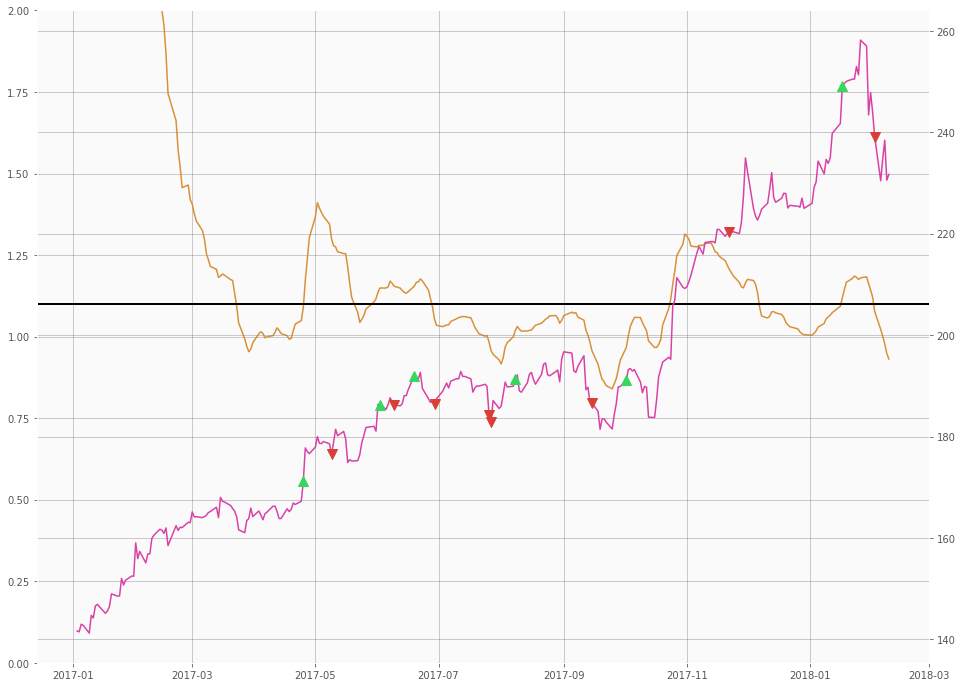

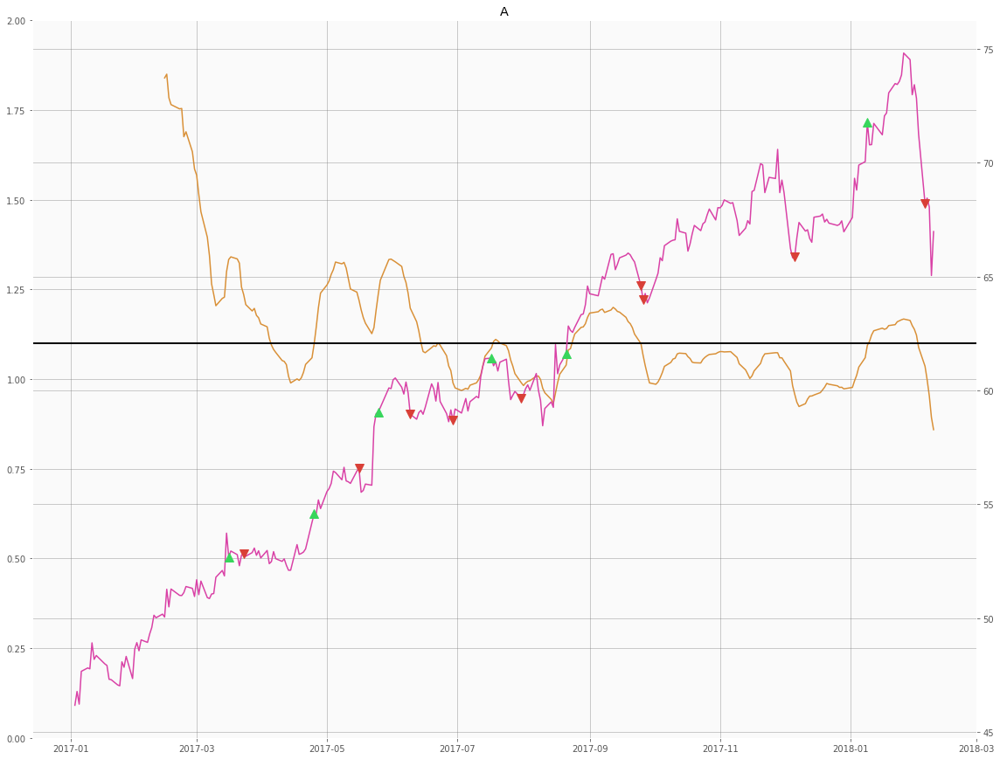

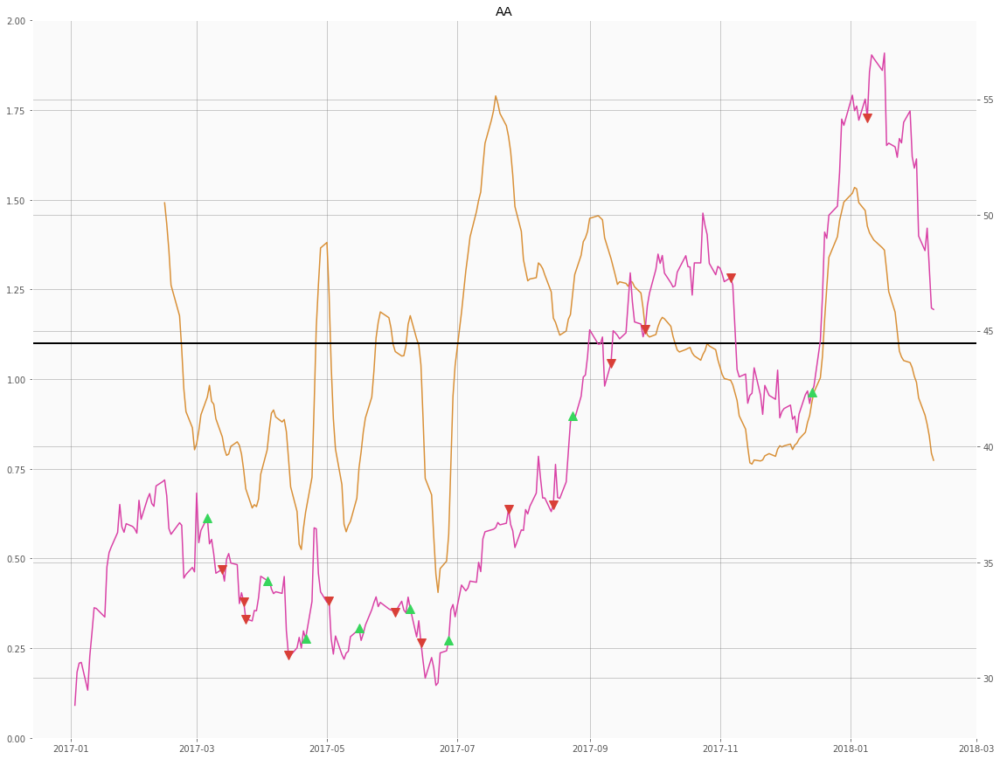

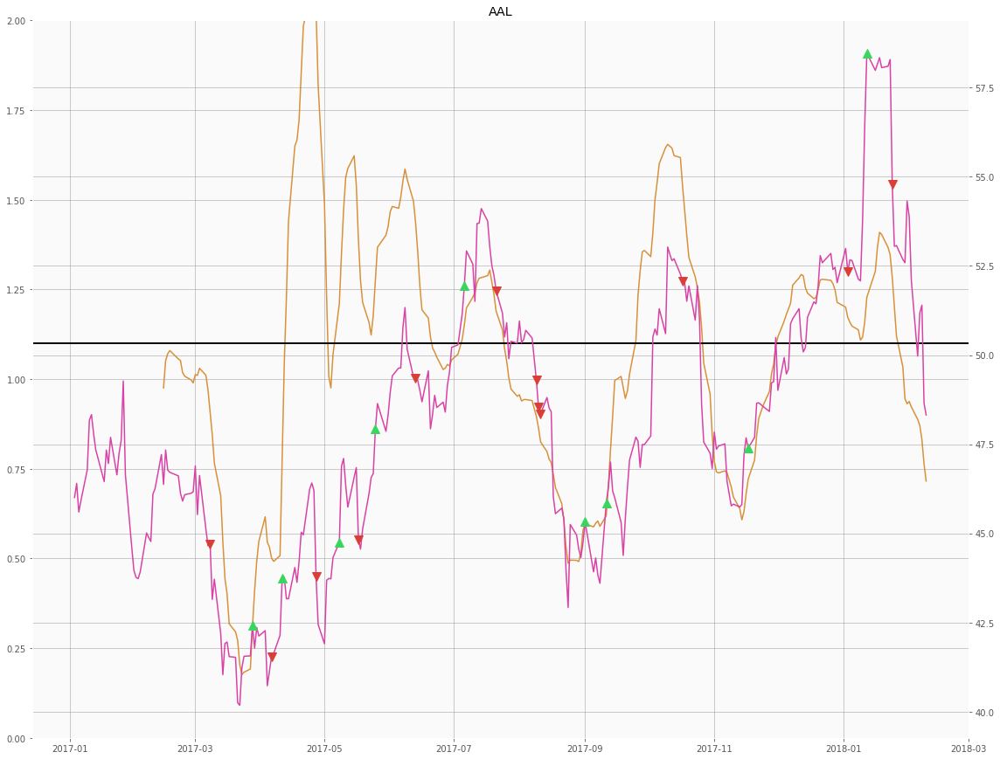

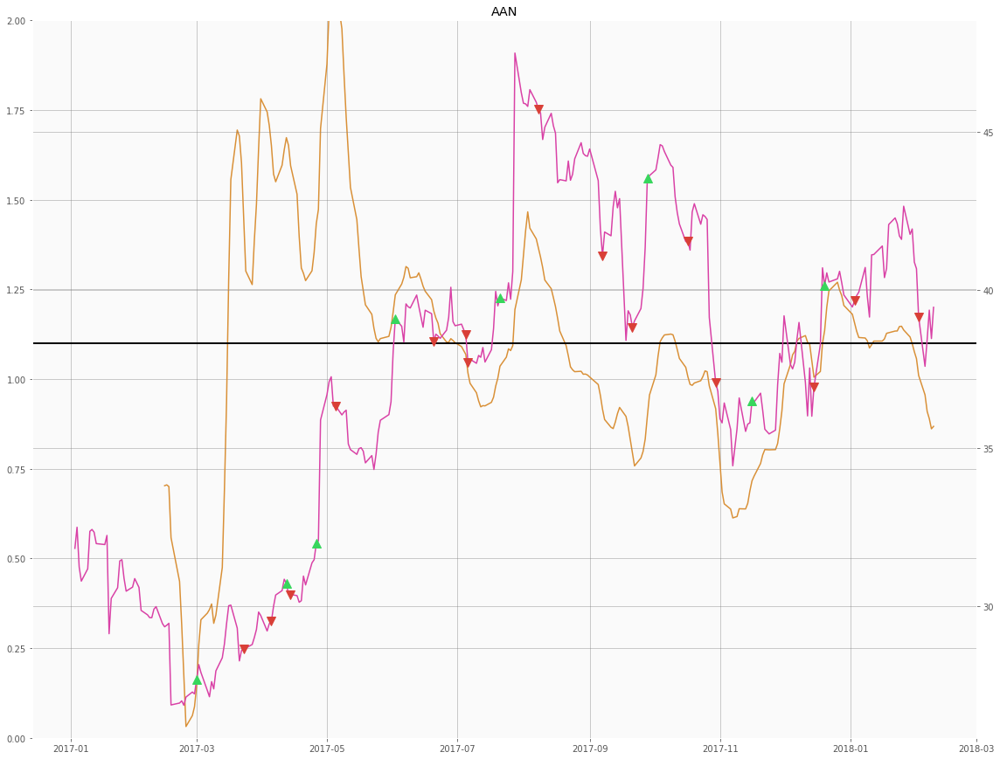

...

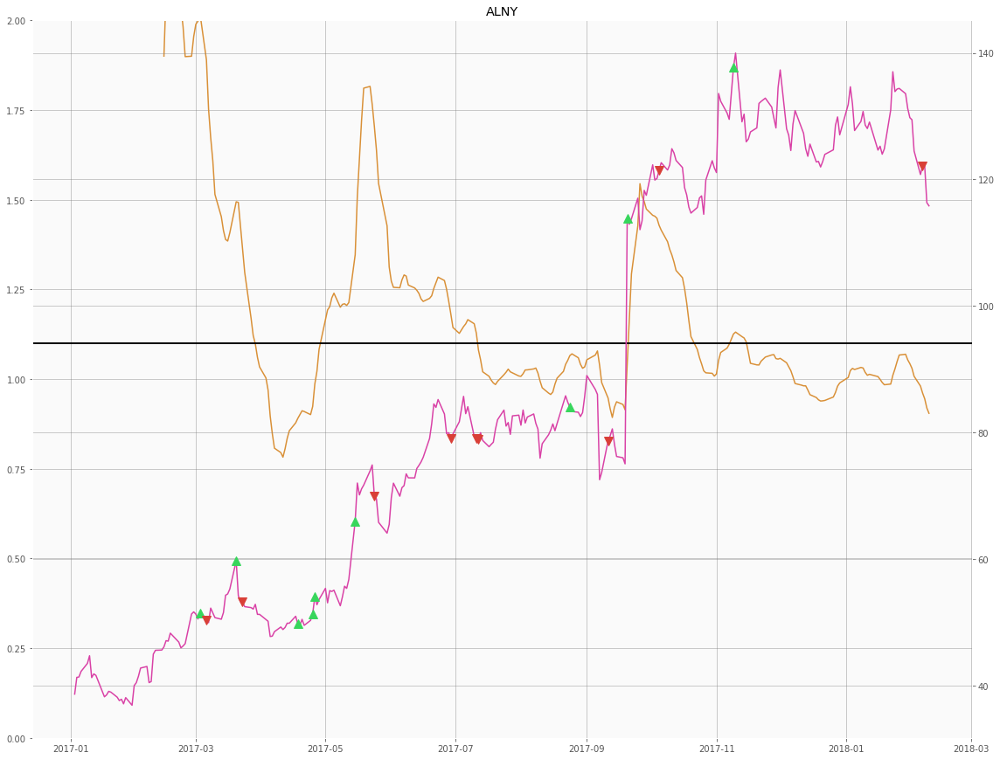

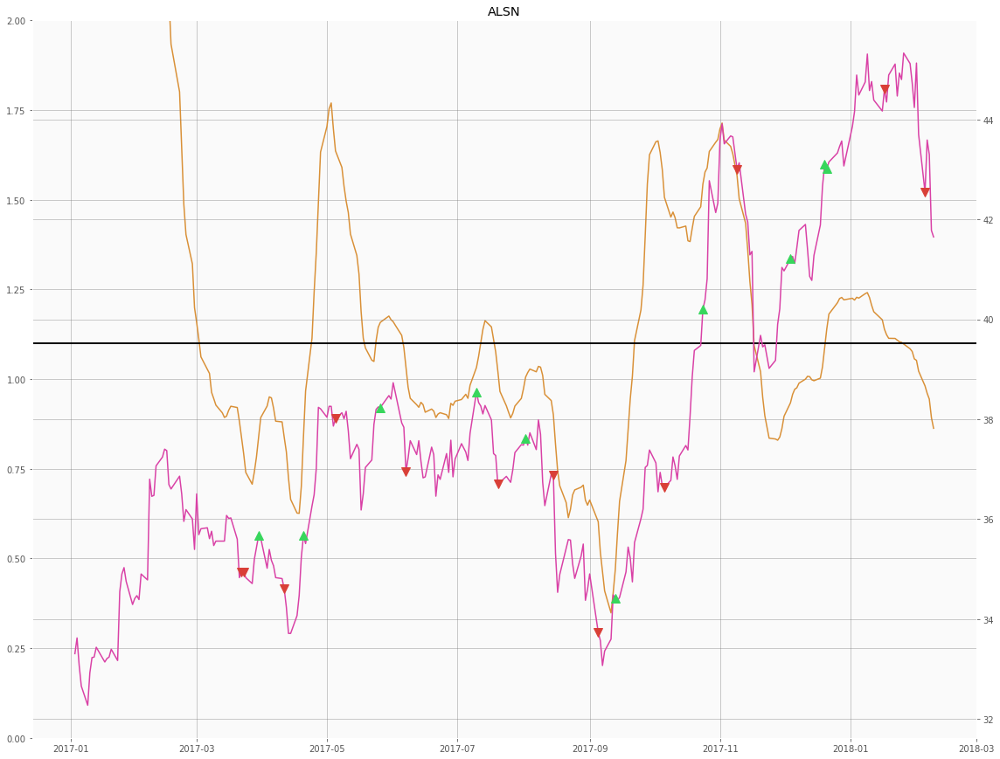

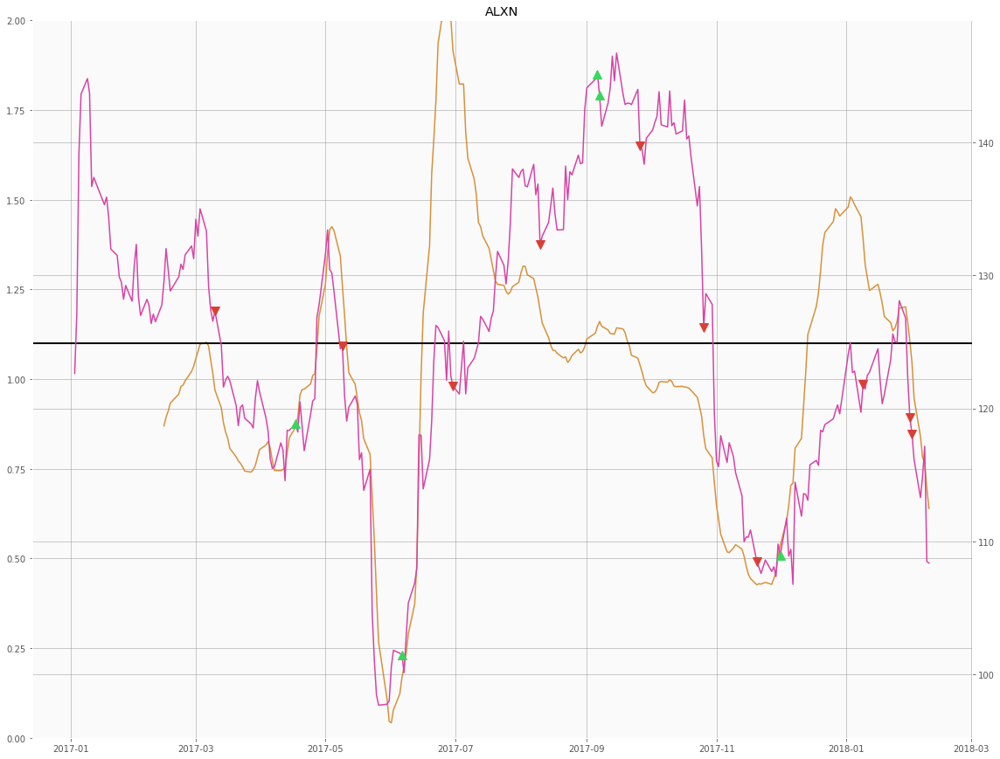

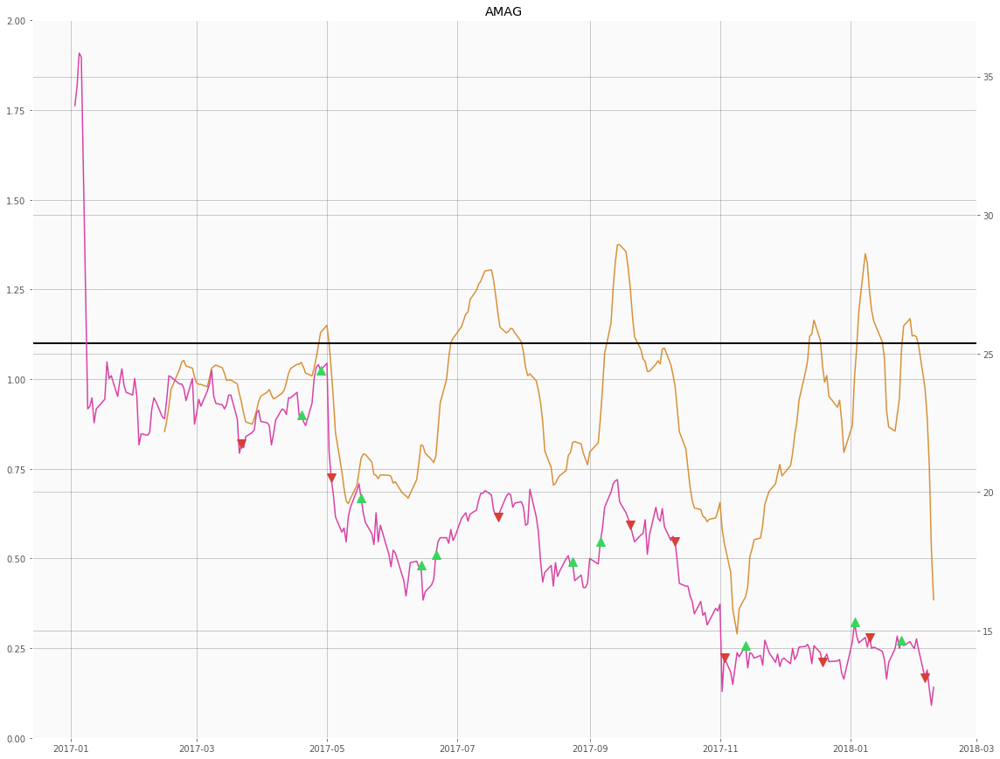

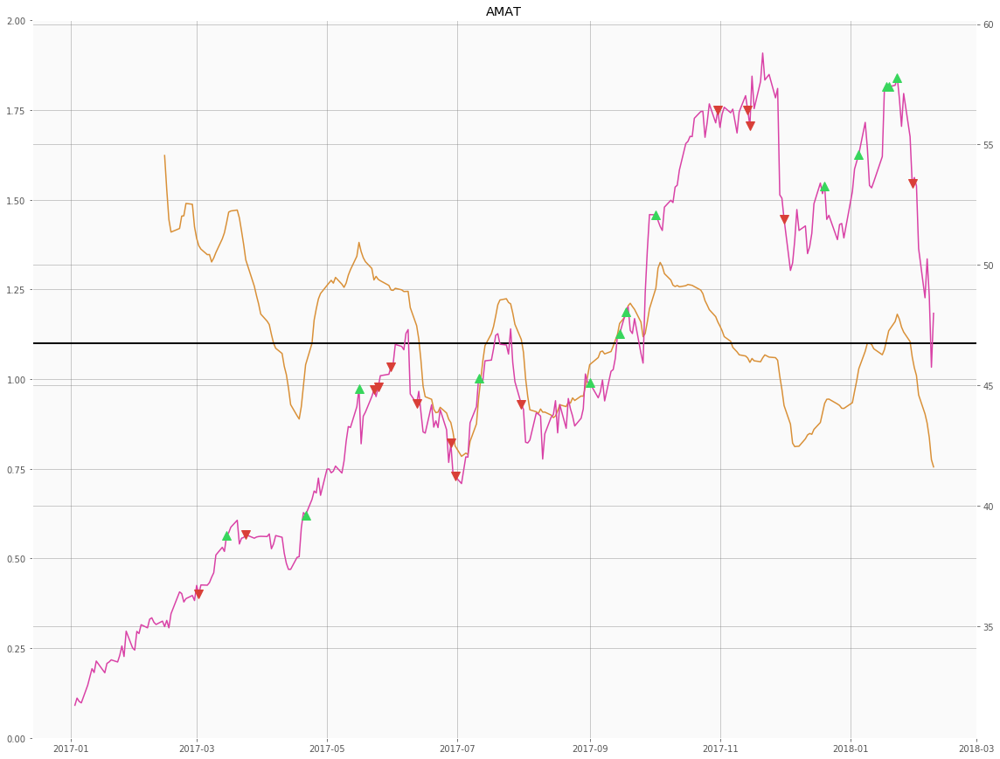

KeyboardInterrupt: 

In [370]:
for sym in all_sym_df.Symbol.unique():
    
    sym_df = all_sym_df.loc[all_sym_df.Symbol == sym]
    fig, ax1 = plt.subplots(figsize=(16,12))
    
    buy_dates = sym_df[sym_df.Reversal == 1].Date
    sell_dates = sym_df[sym_df.Reversal == -1].Date
    
    buy_prices = sym_df[sym_df.Date.isin(buy_dates)].Close
    sell_prices = sym_df[sym_df.Date.isin(sell_dates)].Close
    
    
    ax1.plot(sym_df.Date,sym_df['Diff'], color = W.colors[3])
    ax1.set_ylim(0,2)
    ax2 = ax1.twinx()
    ax2.plot(sym_df.Date,sym_df['Close'],color = W.colors[4])
    ax2.plot(buy_dates, buy_prices, linestyle = 'None', marker = '^', ms = 10, color = W.colors[2])
    ax2.plot(sell_dates, sell_prices, linestyle = 'None', marker = 'v', ms = 10, color = W.colors[0])
    
    ax1.axhline(1.1, c='black',lw = 2)
    
    fig.tight_layout()
    plt.title('{}'.format(sym))
    plt.show()